___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___

# WELCOME!

Welcome to "***Fraud Detection Project***". This is the last project of the Capstone Series.

One of the challenges in this project is the absence of domain knowledge. So without knowing what the column names are, you will only be interested in their values. The other one is the class frequencies of the target variable are quite imbalanced.

You will implement ***Logistic Regression, Random Forest, XGBoost,and Neural Network*** algorithms and ***Unbalanced Data Techniques*** . Also visualize performances of the models using ***Seaborn, Matplotlib*** and ***other libraries*** in a variety of ways.

Data drift and model drirft are key consepts about ML and MLOPS, you can monitor and check your data and models with plenty of ways and tools. ***Deepchecks*** is one of them and the leading tool for testing and for validating your machine learning models and data, and it enables doing so with minimal effort. In this project, you will apply ***Data Integrity, Train-Test Validation, and Model Evaluation*** checks.
Deepchecks Introduction : https://youtu.be/7ELdizoi6BU

At the end of the project, you will have the opportunity to deploy your model by ***Streamlit API***.

Before diving into the project, please take a look at the Determines and Tasks.

# #Determines
The datasets contains transactions made by credit cards in September 2013 by european cardholders. This dataset presents transactions that occurred in two days, where it has **492 frauds** out of **284,807** transactions. The dataset is **highly unbalanced**, the positive class (frauds) account for 0.172% of all transactions.

**Feature Information:**

**Time**: This feature is contains the seconds elapsed between each transaction and the first transaction in the dataset. 

**Amount**:  This feature is the transaction Amount, can be used for example-dependant cost-senstive learning. 

**Class**: This feature is the target variable and it takes value 1 in case of fraud and 0 otherwise.

---

The aim of this project is to predict whether a credit card transaction is fraudulent. Of course, this is not easy to do.
First of all, you need to analyze and recognize your data well in order to draw your roadmap and choose the correct arguments you will use. Accordingly, you can examine the frequency distributions of variables. You can observe variable correlations and want to explore multicollinearity. You can display the distribution of the target variable's classes over other variables. 
Also, it is useful to take missing values and outliers.

After these procedures, you can move on to the model building stage by doing the basic data pre-processing you are familiar with. 

Start with Logistic Regression and evaluate model performance. You will apply the Unbalanced Data Techniques used to increase the performance. Next, observe their effects.

Then, you will use four different algorithms in the model building phase. 

In the final step, you will deploy your model using ***Streamlit API***. 

# #Tasks

#### 1. Exploratory Data Analysis & Data Cleaning

- Import Modules, Load Data & Data Review
- Apply data integrity checks
- Exploratory Data Analysis
- Data Cleaning
    
#### 2. Data Preprocessing

- Train - Test Split
- Train - Test Split Validation Checks
- Scaling

#### 3. Model Building

- Logistic Regression 
- Random Forest Classifier
- XGBoost Classifier
- Neural Network
- 

#### 4. Model Deployement

- Save and Export the Best Model
- Save and Export Variables




---
---


## 1. Exploratory Data Analysis & Data Cleaning

### Import Modules, Load Data & Data Review

In [92]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime as dt
from datetime import datetime
from datetime import timedelta
import plotly.express as px
import plotly.graph_objects as go
import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
cf.go_offline()

from sklearn.preprocessing import PowerTransformer, StandardScaler, scale, OneHotEncoder, OrdinalEncoder, MinMaxScaler
from sklearn.compose import make_column_transformer
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.metrics import silhouette_samples, silhouette_score, calinski_harabasz_score, davies_bouldin_score, adjusted_rand_score, mean_squared_error, mean_absolute_error, r2_score, accuracy_score, f1_score, recall_score, precision_score, confusion_matrix, classification_report, make_scorer, precision_recall_curve, PrecisionRecallDisplay
from sklearn.model_selection import GridSearchCV, cross_validate, train_test_split
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier


from xgboost import XGBClassifier
from sklearn.utils import class_weight
from scikitplot.metrics import plot_precision_recall, plot_roc, precision_recall_curve
from scipy.cluster.hierarchy import linkage, dendrogram
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.neighbors import KNeighborsClassifier
import math
import pickle
from scipy.stats import chi2_contingency, skew, stats


import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import Dropout
from tensorflow.keras.optimizers import Adam, Adadelta, RMSprop, Nadam
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier
from tensorflow.keras.models import load_model

from ipywidgets import interact
from scipy.stats import levene
from collections import Counter
from livelossplot import PlotLossesKerasTF
import matplotlib.gridspec as gridspec
import colorama
from colorama import Fore, Style  # makes strings colored
from sklearn.preprocessing import MinMaxScaler,StandardScaler,RobustScaler,OrdinalEncoder,OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier    
from deepchecks.tabular.suites import model_evaluation
from sklearn.model_selection import cross_validate
from xgboost import XGBClassifier
from scikitplot.metrics import plot_roc, precision_recall_curve
from scikitplot.metrics import plot_precision_recall
from sklearn.metrics import matthews_corrcoef
import shap
from deepchecks.tabular.suites import model_evaluation
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline as imbpipeline
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from tensorflow.keras.layers import Dense, BatchNormalization
from sklearn.compose import make_column_transformer
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline as Pipeline_imb
import xgboost as xgb
from xgboost import XGBClassifier
from sklearn.utils import class_weight
from deepchecks.tabular.suites import model_evaluation
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, ConfusionMatrixDisplay
from sklearn.metrics import precision_recall_curve
from yellowbrick.model_selection import FeatureImportances
from yellowbrick.features import RadViz
from yellowbrick.classifier import PrecisionRecallCurve
from yellowbrick.classifier import ConfusionMatrix
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline as imbpipeline
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve
from yellowbrick.classifier import PrecisionRecallCurve
from sklearn.metrics import average_precision_score
from sklearn.ensemble import RandomForestClassifier

import warnings
warnings.filterwarnings('ignore')

In [2]:
df0 = pd.read_csv("creditcard.csv")

In [3]:
df = df0.copy()

In [4]:
df.sample(10)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
225285,144188.0,2.095694,-0.129794,-2.222492,-0.150389,0.981225,-0.016711,0.261049,-0.085069,0.549156,...,0.080291,0.302268,-0.097006,-0.480032,0.470421,-0.494724,-0.022243,-0.073969,15.00,0
198306,132429.0,-0.110419,0.585888,0.284230,0.213940,1.007298,0.979354,0.395478,0.305939,0.413705,...,-0.447535,-0.998069,0.235254,-0.276079,-0.686827,-1.230120,0.254620,0.150654,22.63,0
273591,165626.0,1.988831,-0.348809,-0.473216,0.119904,-0.469956,-0.259559,-0.590608,0.101656,1.177002,...,-0.104253,-0.218269,0.288758,-0.566259,-0.351380,-0.912305,0.051582,-0.043041,1.00,0
97339,66174.0,1.385935,-0.459787,0.472559,-0.859489,-0.860634,-0.510664,-0.628431,-0.051624,-1.074580,...,-0.061249,-0.304899,0.075521,0.003381,0.262535,-0.478949,0.009532,0.010332,9.12,0
183278,125731.0,-0.556807,0.107543,0.792972,0.338579,-1.844728,1.021859,1.404927,-0.172524,-1.109448,...,0.058100,0.975360,0.104041,1.089692,-0.275048,-0.298058,0.528557,0.178986,362.50,0
91601,63549.0,-0.832757,0.639897,0.909215,-0.151990,2.694040,4.100211,-0.056880,1.178139,-0.575544,...,0.106765,0.171077,-0.331330,0.998254,0.391015,-0.158286,0.073099,0.105788,5.30,0
56256,47339.0,1.184662,-0.216035,0.651774,-0.168070,-0.769154,-0.379905,-0.482859,0.188342,0.333287,...,-0.058520,-0.224482,0.157778,0.247821,-0.060009,0.908928,-0.066832,-0.005374,0.77,0
120551,75865.0,-10.339506,8.312165,-4.163599,-1.491819,-3.907534,-1.897366,-1.684557,2.981368,5.009010,...,-1.144535,-1.141896,0.559279,0.556080,1.367721,-0.043435,0.602709,-0.547908,10.74,0
145687,87134.0,1.819399,-0.746055,-0.422551,0.274443,-0.819001,-0.460513,-0.496639,-0.099180,1.437531,...,0.292792,0.942176,-0.000943,-0.095425,-0.127879,0.185139,0.005668,-0.027822,100.00,0
224412,143780.0,1.849328,-0.269723,-1.159366,1.566456,-0.146747,-0.827112,0.250073,-0.258708,0.772467,...,0.210647,0.721363,-0.109927,0.060905,0.387814,-0.382480,-0.004132,-0.042172,84.61,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [6]:
df.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [7]:
df.duplicated().sum()

1081

In [8]:
df.shape

(284807, 31)

In [9]:
df.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

In [10]:
df.Class.value_counts(normalize=True)

0    0.998273
1    0.001727
Name: Class, dtype: float64

In [11]:
def check_df(col):
  print('column name : ', col)
  print('--------------------------------')
  print('Per_of_Nulls           : ', '%', round(df[col].isnull().sum()*100/len(df), 2))
  print('Num_of_Nulls           : ', df[col].isnull().sum())
  print('Num_of_Unique_Values   : ', df[col].nunique())
  print(df[col].value_counts(dropna = False))
  print("*"*30)
  print("\n\n")


for col in df.columns :
  check_df(col)

column name :  Time
--------------------------------
Per_of_Nulls           :  % 0.0
Num_of_Nulls           :  0
Num_of_Unique_Values   :  124592
163152.0    36
64947.0     26
68780.0     25
3767.0      21
3770.0      20
            ..
127750.0     1
62260.0      1
62259.0      1
127753.0     1
172792.0     1
Name: Time, Length: 124592, dtype: int64
******************************



column name :  V1
--------------------------------
Per_of_Nulls           :  % 0.0
Num_of_Nulls           :  0
Num_of_Unique_Values   :  275663
 2.055797    77
 1.245674    77
 2.053311    62
 1.302378    60
 2.040211    53
             ..
-0.938907     1
 1.375417     1
-3.762431     1
 1.420284     1
-0.533413     1
Name: V1, Length: 275663, dtype: int64
******************************



column name :  V2
--------------------------------
Per_of_Nulls           :  % 0.0
Num_of_Nulls           :  0
Num_of_Unique_Values   :  275663
-0.326668    77
 0.166975    77
 0.089735    62
-0.606529    60
-0.146975    

 0.269765    77
-0.262581    77
-0.361158    62
-0.064208    60
-0.352334    53
             ..
 0.210512     1
-0.458449     1
-2.217422     1
 0.063577     1
 0.261057     1
Name: V21, Length: 275663, dtype: int64
******************************



column name :  V22
--------------------------------
Per_of_Nulls           :  % 0.0
Num_of_Nulls           :  0
Num_of_Unique_Values   :  275663
 0.844627    77
-0.816264    77
-0.984262    62
-0.080587    60
-0.996937    53
             ..
 0.600703     1
-0.791131     1
-1.673874     1
 0.377741     1
 0.643078     1
Name: V22, Length: 275663, dtype: int64
******************************



column name :  V23
--------------------------------
Per_of_Nulls           :  % 0.0
Num_of_Nulls           :  0
Num_of_Unique_Values   :  275663
 0.020675    77
 0.140304    77
 0.354198    62
-0.072991    60
 0.363485    53
             ..
-0.119788     1
 0.011987     1
 0.635783     1
-0.114340     1
 0.376777     1
Name: V23, Length: 275663, dtype: 

## Apply Data Integrity Checks
* link: https://docs.deepchecks.com/stable/user-guide/tabular/auto_quickstarts/plot_quick_data_integrity.html

In [12]:
import sys
from deepchecks.tabular import Dataset
from deepchecks.tabular.suites import data_integrity

In [13]:
ds = Dataset(df, cat_features= [], label='Class')

In [14]:
# Run Suite:
integ_suite = data_integrity()
suite_result = integ_suite.run(ds)
# Note: the result can be saved as html using suite_result.save_as_html()
# or exported to json using suite_result.to_json()
suite_result.show()

Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_SSXC9QK1OCZCDHIPZ1J7E1NJQ">Data Integrity Sui…

In [15]:
from deepchecks.tabular.checks import IsSingleValue, DataDuplicates

In [16]:
# first let's see how the check runs:
IsSingleValue().run(ds)

In [17]:
# we can also add a condition:
single_value_with_condition = IsSingleValue().add_condition_not_single_value()
result = single_value_with_condition.run(ds)
result.show()

In [18]:
# We can also inspect and use the result's value:
result.value

{'Time': 124592,
 'V1': 275663,
 'V2': 275663,
 'V3': 275663,
 'V4': 275663,
 'V5': 275663,
 'V6': 275663,
 'V7': 275663,
 'V8': 275663,
 'V9': 275663,
 'V10': 275663,
 'V11': 275663,
 'V12': 275663,
 'V13': 275663,
 'V14': 275663,
 'V15': 275663,
 'V16': 275663,
 'V17': 275663,
 'V18': 275663,
 'V19': 275663,
 'V20': 275663,
 'V21': 275663,
 'V22': 275663,
 'V23': 275663,
 'V24': 275663,
 'V25': 275663,
 'V26': 275663,
 'V27': 275663,
 'V28': 275663,
 'Amount': 32767,
 'Class': 2}

In [19]:
df.drop_duplicates(inplace = True)
 ## Lets check again after dropping duplicate rows.

In [20]:
ds =  Dataset(df, label="Class", cat_features=[])

In [21]:
# Run Suite:
integ_suite = data_integrity()
suite_result = integ_suite.run(ds)
# Note: the result can be saved as html using suite_result.save_as_html()
# or exported to json using suite_result.to_json()
suite_result.show()

Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_AISAE752IE7L6I3WVYSHCIAVA">Data Integrity Sui…

In [22]:
#we drop probable ouliers who belong to 0 class
df.drop(df.index[[13942, 230962,234519]], inplace = True)
df.reset_index(inplace=True, drop=True)


In [23]:
integ_suite

Data Integrity Suite: [
	0: IsSingleValue
		Conditions:
			0: Does not contain only a single value
	1: SpecialCharacters
		Conditions:
			0: Ratio of samples containing solely special character is less or equal to 0.1%
	2: MixedNulls
		Conditions:
			0: Number of different null types is less or equal to 1
	3: MixedDataTypes
		Conditions:
			0: Rare data types in column are either more than 10% or less than 1% of the data
	4: StringMismatch
		Conditions:
			0: No string variants
	5: DataDuplicates
		Conditions:
			0: Duplicate data ratio is less or equal to 5%
	6: StringLengthOutOfBounds
		Conditions:
			0: Ratio of string length outliers is less or equal to 0%
	7: ConflictingLabels
		Conditions:
			0: Ambiguous sample ratio is less or equal to 0%
	8: OutlierSampleDetection
	9: FeatureLabelCorrelation(ppscore_params={}, random_state=42)
		Conditions:
			0: Features' Predictive Power Score is less than 0.8
	10: FeatureFeatureCorrelation
		Conditions:
			0: Not more than 0 pairs are corre

### Exploratory Data Analysis

In [24]:
df.shape

(283723, 31)

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 283723 entries, 0 to 283722
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    283723 non-null  float64
 1   V1      283723 non-null  float64
 2   V2      283723 non-null  float64
 3   V3      283723 non-null  float64
 4   V4      283723 non-null  float64
 5   V5      283723 non-null  float64
 6   V6      283723 non-null  float64
 7   V7      283723 non-null  float64
 8   V8      283723 non-null  float64
 9   V9      283723 non-null  float64
 10  V10     283723 non-null  float64
 11  V11     283723 non-null  float64
 12  V12     283723 non-null  float64
 13  V13     283723 non-null  float64
 14  V14     283723 non-null  float64
 15  V15     283723 non-null  float64
 16  V16     283723 non-null  float64
 17  V17     283723 non-null  float64
 18  V18     283723 non-null  float64
 19  V19     283723 non-null  float64
 20  V20     283723 non-null  float64
 21  V21     28

In [26]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Time,283723.0,94810.951587,47480.910096,0.000000,54205.500000,84692.000000,139298.000000,172792.000000
V1,283723.0,0.005899,1.948028,-56.407510,-0.915963,0.020374,1.316046,2.454930
V2,283723.0,-0.004132,1.646710,-72.715728,-0.600317,0.063952,0.800284,22.057729
V3,283723.0,0.001623,1.508686,-48.325589,-0.889676,0.179993,1.026981,9.382558
V4,283723.0,-0.002967,1.414190,-5.683171,-0.850146,-0.022256,0.739666,16.875344
V5,283723.0,0.001829,1.377015,-113.743307,-0.689824,-0.053469,0.612226,34.801666
V6,283723.0,-0.001131,1.331934,-26.160506,-0.769030,-0.275164,0.396811,73.301626
V7,283723.0,0.001800,1.227670,-43.557242,-0.552524,0.040862,0.570479,120.589494
V8,283723.0,-0.000851,1.179060,-73.216718,-0.208827,0.021903,0.325713,20.007208
V9,283723.0,-0.001601,1.095495,-13.434066,-0.644225,-0.052596,0.595976,15.594995


#### 1. Target Column : Class ----------> This feature is the target variable and it takes value 1 in case of fraud and 0 otherwise.

In [27]:
df.Class.value_counts()

0    283250
1       473
Name: Class, dtype: int64

In [28]:
# Check the percentage of classes and visualize it with a pieplot

fig = px.pie(df, 
             values = df.Class.value_counts(), 
             names = (df.Class.value_counts()).index, 
             title = 'Percentage of Fraud')
fig.show()

In [29]:
import plotly.graph_objects as go

amount_fraud = df.Class.value_counts().sort_values(ascending=False)

fig = go.Figure(data=[go.Bar(
    x=amount_fraud.index,
    y=amount_fraud.values,
    marker=dict(
        color=amount_fraud.values,  
        coloraxis="coloraxis"  
    )
)])

fig.update_layout(
    title='Number of Fraud',
    xaxis=dict(title='Fraud'),
    yaxis=dict(title='Count'),
    xaxis_tickangle=-45,
    hovermode='x',
    showlegend=False,
    coloraxis=dict(colorscale='PiYG')  
)

fig.show()

In [30]:
df[df["Class"]== 1]

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
534,406.0,-2.312227,1.951992,-1.609851,3.997906,-0.522188,-1.426545,-2.537387,1.391657,-2.770089,...,0.517232,-0.035049,-0.465211,0.320198,0.044519,0.177840,0.261145,-0.143276,0.00,1
616,472.0,-3.043541,-3.157307,1.088463,2.288644,1.359805,-1.064823,0.325574,-0.067794,-0.270953,...,0.661696,0.435477,1.375966,-0.293803,0.279798,-0.145362,-0.252773,0.035764,529.00,1
4886,4462.0,-2.303350,1.759247,-0.359745,2.330243,-0.821628,-0.075788,0.562320,-0.399147,-0.238253,...,-0.294166,-0.932391,0.172726,-0.087330,-0.156114,-0.542628,0.039566,-0.153029,239.93,1
6072,6986.0,-4.397974,1.358367,-2.592844,2.679787,-1.128131,-1.706536,-3.496197,-0.248778,-0.247768,...,0.573574,0.176968,-0.436207,-0.053502,0.252405,-0.657488,-0.827136,0.849573,59.00,1
6293,7519.0,1.234235,3.019740,-4.304597,4.732795,3.624201,-1.357746,1.713445,-0.496358,-1.282858,...,-0.379068,-0.704181,-0.656805,-1.632653,1.488901,0.566797,-0.010016,0.146793,1.00,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
278810,169142.0,-1.927883,1.125653,-4.518331,1.749293,-1.566487,-2.010494,-0.882850,0.697211,-2.064945,...,0.778584,-0.319189,0.639419,-0.294885,0.537503,0.788395,0.292680,0.147968,390.00,1
279087,169347.0,1.378559,1.289381,-5.004247,1.411850,0.442581,-1.326536,-1.413170,0.248525,-1.127396,...,0.370612,0.028234,-0.145640,-0.081049,0.521875,0.739467,0.389152,0.186637,0.76,1
279093,169351.0,-0.676143,1.126366,-2.213700,0.468308,-1.120541,-0.003346,-2.234739,1.210158,-0.652250,...,0.751826,0.834108,0.190944,0.032070,-0.739695,0.471111,0.385107,0.194361,77.89,1
280078,169966.0,-3.113832,0.585864,-5.399730,1.817092,-0.840618,-2.943548,-2.208002,1.058733,-1.632333,...,0.583276,-0.269209,-0.456108,-0.183659,-0.328168,0.606116,0.884876,-0.253700,245.00,1


In [31]:
df[df["Class"]== 0]

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
283718,172786.0,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,...,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0
283719,172787.0,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,...,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0
283720,172788.0,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,...,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0
283721,172788.0,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,...,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0


In [32]:
df.Class.describe()

count    283723.000000
mean          0.001667
std           0.040796
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: Class, dtype: float64

#### 2. Time: This feature is contains the seconds elapsed between each transaction and the first transaction in the dataset.

In [33]:
df.Time.value_counts()

3767.0      21
3770.0      20
3750.0      19
19912.0     19
3749.0      17
            ..
127732.0     1
62217.0      1
127739.0     1
62210.0      1
172792.0     1
Name: Time, Length: 124592, dtype: int64

In [34]:
df.Time.describe()

count    283723.000000
mean      94810.951587
std       47480.910096
min           0.000000
25%       54205.500000
50%       84692.000000
75%      139298.000000
max      172792.000000
Name: Time, dtype: float64

<Axes: xlabel='Time', ylabel='Count'>

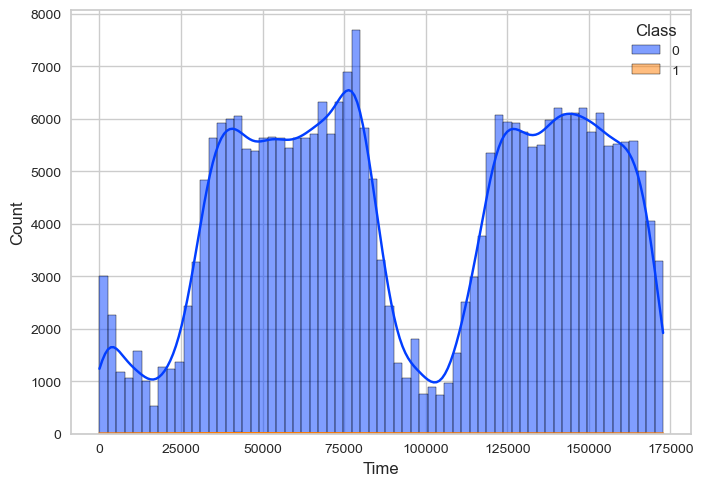

In [35]:
sns.histplot(data =df, x = "Time",palette = "bright",hue ="Class",kde= True)

In [36]:
df.groupby("Class")["Time"].value_counts()

Class  Time    
0      3767.0      21
       3770.0      20
       3750.0      19
       19912.0     19
       3749.0      17
                   ..
1      169142.0     1
       169347.0     1
       169351.0     1
       169966.0     1
       170348.0     1
Name: Time, Length: 124947, dtype: int64

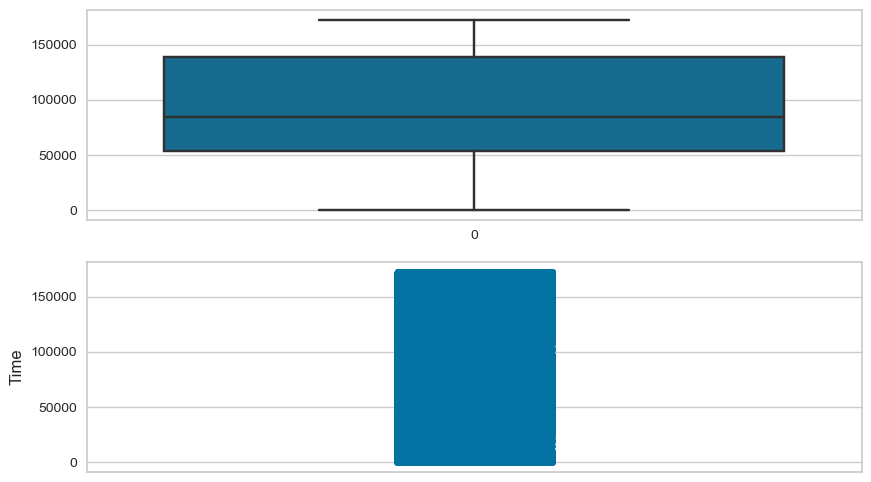

In [37]:
plt.figure(figsize=(10,6))

plt.subplot(211)
sns.boxplot(df.Time)

plt.subplot(212)
sns.stripplot(df.Time);

#### 3. Amount: This feature is the transaction Amount, can be used for example-dependant cost-senstive learning

In [38]:
df.Amount.value_counts()

1.00      13566
1.98       6043
0.89       4871
9.99       4738
15.00      3280
          ...  
526.60        1
248.16        1
492.65        1
811.50        1
95.63         1
Name: Amount, Length: 32767, dtype: int64

In [39]:
nonfraud = df[df.Class==0]
fraud = df[df.Class==1]

print("Total Amount\t\t   : ", np.round(df.Amount.sum(), decimals=2))
print("Fraud Amount\t\t   : ", np.round(fraud.Amount.sum(), decimals=2))
print("Non-Fraud Amount\t   : ", np.round(nonfraud.Amount.sum(), decimals=2))
print("Percentage of Fraud Amount : ", np.round((fraud.Amount.sum()/df.Amount.sum())*100, decimals=2))

Total Amount		   :  25101780.95
Fraud Amount		   :  58591.39
Non-Fraud Amount	   :  25043189.56
Percentage of Fraud Amount :  0.23


<Axes: xlabel='Amount', ylabel='Count'>

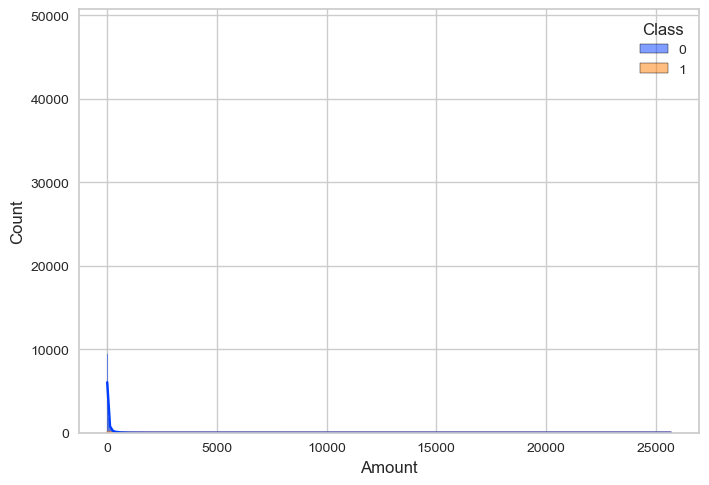

In [40]:
sns.histplot(data =df, x = "Amount",palette = "bright",hue ="Class",kde= True)

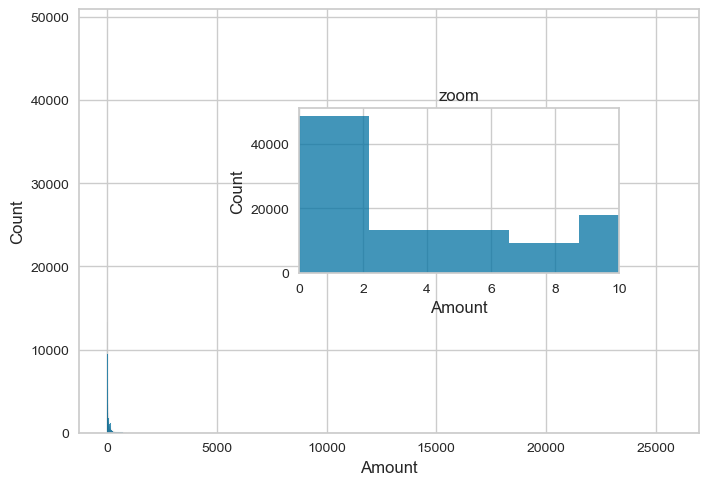

In [41]:
fig, ax = plt.subplots()
sns.histplot(data = df, x = "Amount", ax=ax);

ax2 = plt.axes([0.4, 0.4, .4, .3], facecolor='w')
sns.histplot(data = df, x = "Amount", ax=ax2);
ax2.set_title('zoom')
ax2.set_xlim([0,10]);

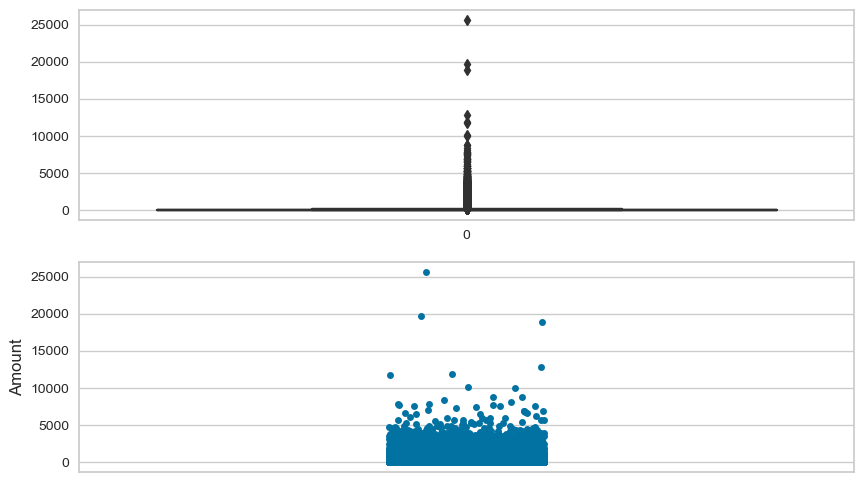

In [42]:
plt.figure(figsize=(10,6))

plt.subplot(211)
sns.boxplot(df.Amount)

plt.subplot(212)
sns.stripplot(df.Amount);

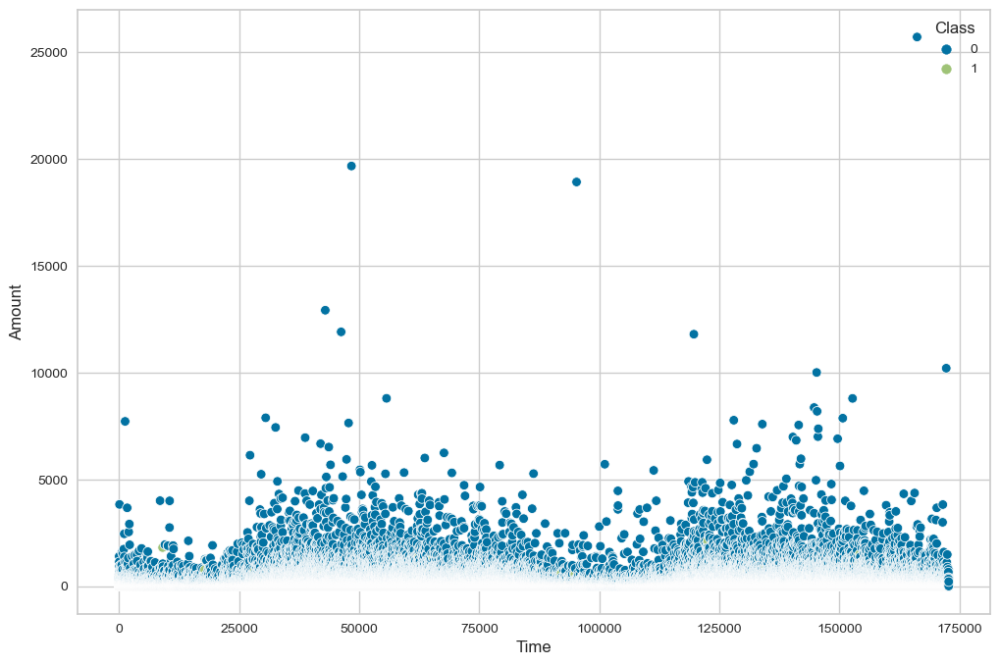

In [43]:
fig = plt.figure(figsize=(12, 8))

sns.scatterplot(data=df, x='Time', y='Amount',hue="Class")
plt.show()

## Fraud vs. Non-Fraud

In [44]:
df_fraud = df[df["Class"] ==1]
df_fraud.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
534,406.0,-2.312227,1.951992,-1.609851,3.997906,-0.522188,-1.426545,-2.537387,1.391657,-2.770089,...,0.517232,-0.035049,-0.465211,0.320198,0.044519,0.177840,0.261145,-0.143276,0.00,1
616,472.0,-3.043541,-3.157307,1.088463,2.288644,1.359805,-1.064823,0.325574,-0.067794,-0.270953,...,0.661696,0.435477,1.375966,-0.293803,0.279798,-0.145362,-0.252773,0.035764,529.00,1
4886,4462.0,-2.303350,1.759247,-0.359745,2.330243,-0.821628,-0.075788,0.562320,-0.399147,-0.238253,...,-0.294166,-0.932391,0.172726,-0.087330,-0.156114,-0.542628,0.039566,-0.153029,239.93,1
6072,6986.0,-4.397974,1.358367,-2.592844,2.679787,-1.128131,-1.706536,-3.496197,-0.248778,-0.247768,...,0.573574,0.176968,-0.436207,-0.053502,0.252405,-0.657488,-0.827136,0.849573,59.00,1
6293,7519.0,1.234235,3.019740,-4.304597,4.732795,3.624201,-1.357746,1.713445,-0.496358,-1.282858,...,-0.379068,-0.704181,-0.656805,-1.632653,1.488901,0.566797,-0.010016,0.146793,1.00,1


In [45]:
df_fraud.describe().T

,count,mean,std,min,25%,50%,75%,max
Time,473.0,80450.513742,48636.179973,406.000000,41203.000000,73408.000000,129095.000000,170348.000000
V1,473.0,-4.498280,6.593145,-30.552380,-5.603690,-2.271755,-0.361428,2.132386
V2,473.0,3.405965,4.122500,-8.402154,1.145381,2.617105,4.571743,22.057729
V3,473.0,-6.729599,6.909647,-31.103685,-7.926507,-4.875397,-2.171454,2.250210
V4,473.0,4.472591,2.871523,-1.313275,2.288644,4.100098,6.290918,12.114672
V5,473.0,-2.957197,5.278831,-22.105532,-4.278983,-1.372245,0.260821,11.095089
V6,473.0,-1.432518,1.715347,-6.406267,-2.450444,-1.420468,-0.413647,6.474115
V7,473.0,-5.175912,6.858024,-43.557242,-6.989195,-2.902079,-0.907188,5.802537
V8,473.0,0.953255,5.585950,-41.044261,-0.161518,0.617738,1.709417,20.007208
V9,473.0,-2.522124,2.465047,-13.434066,-3.796760,-2.099049,-0.788388,3.353525


In [46]:
df_nonfraud = df[df["Class"] ==0]
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [47]:
df_nonfraud.describe().T

,count,mean,std,min,25%,50%,75%,max
Time,283250.0,94834.932124,47475.412572,0.000000,54233.250000,84711.000000,139307.750000,172792.000000
V1,283250.0,0.013420,1.922181,-56.407510,-0.913436,0.022485,1.316779,2.454930
V2,283250.0,-0.009826,1.633527,-72.715728,-0.601393,0.062564,0.797013,18.902453
V3,283250.0,0.012863,1.457596,-48.325589,-0.883935,0.182281,1.028274,9.382558
V4,283250.0,-0.010441,1.398581,-5.683171,-0.851609,-0.024509,0.734246,16.875344
V5,283250.0,0.006770,1.355823,-113.743307,-0.687886,-0.052807,0.612445,34.801666
V6,283250.0,0.001259,1.329918,-26.160506,-0.767539,-0.274157,0.397688,73.301626
V7,283250.0,0.010446,1.177486,-31.764946,-0.550155,0.041665,0.571043,120.589494
V8,283250.0,-0.002444,1.157146,-73.216718,-0.208838,0.021635,0.324475,18.709255
V9,283250.0,0.002609,1.086904,-6.290730,-0.641664,-0.051370,0.596967,15.594995


In [48]:
# İlk histogram için figürü oluşturun
fig = go.Figure()

# df_fraud veri setini kullanarak ilk histogramı ekleyin
fig.add_trace(go.Histogram(x=df_fraud['Time'], name='Fraud', opacity=0.75))

# df_nonfraud veri setini kullanarak ikinci histogramı ekleyin
fig.add_trace(go.Histogram(x=df_nonfraud['Time'], name='Non-Fraud', opacity=0.75))

# Grafik düzenlemelerini yapın
fig.update_layout(barmode='overlay', title='Fraud vs Non-Fraud Time Distribution',
                  xaxis_title='Time', yaxis_title='Count')

# Histogramları gösterin
fig.show()

In [49]:
# Boxplot verilerini oluşturun
fraud_box = go.Box(y=df_fraud['Time'], name='Fraud')
nonfraud_box = go.Box(y=df_nonfraud['Time'], name='Non-Fraud')

# Grafik düzenlemelerini yapın
layout = go.Layout(title='Fraud vs Non-Fraud Time Boxplot',
                   yaxis_title='Time')

# Grafiği oluşturun
fig = go.Figure(data=[fraud_box, nonfraud_box], layout=layout)

# Grafiği gösterin
fig.show()

In [50]:
# İlk histogram için figürü oluşturun
fig = go.Figure()

# df_fraud veri setini kullanarak ilk histogramı ekleyin
fig.add_trace(go.Histogram(x=df_fraud['Amount'], name='Fraud', opacity=0.75))

# df_nonfraud veri setini kullanarak ikinci histogramı ekleyin
fig.add_trace(go.Histogram(x=df_nonfraud['Amount'], name='Non-Fraud', opacity=0.75))

# Grafik düzenlemelerini yapın
fig.update_layout(barmode='overlay', title='Fraud vs Non-Fraud Amount Distribution',
                  xaxis_title='Amount', yaxis_title='Count')

# Histogramları gösterin
fig.show()

In [51]:
# Boxplot verilerini oluşturun
fraud_box = go.Box(y=df_fraud['Amount'], name='Fraud')
nonfraud_box = go.Box(y=df_nonfraud['Amount'], name='Non-Fraud')

# Grafik düzenlemelerini yapın
layout = go.Layout(title='Fraud vs Non-Fraud Amount Boxplot',
                   yaxis_title='Amount')

# Grafiği oluşturun
fig = go.Figure(data=[fraud_box, nonfraud_box], layout=layout)

# Grafiği gösterin
fig.show()

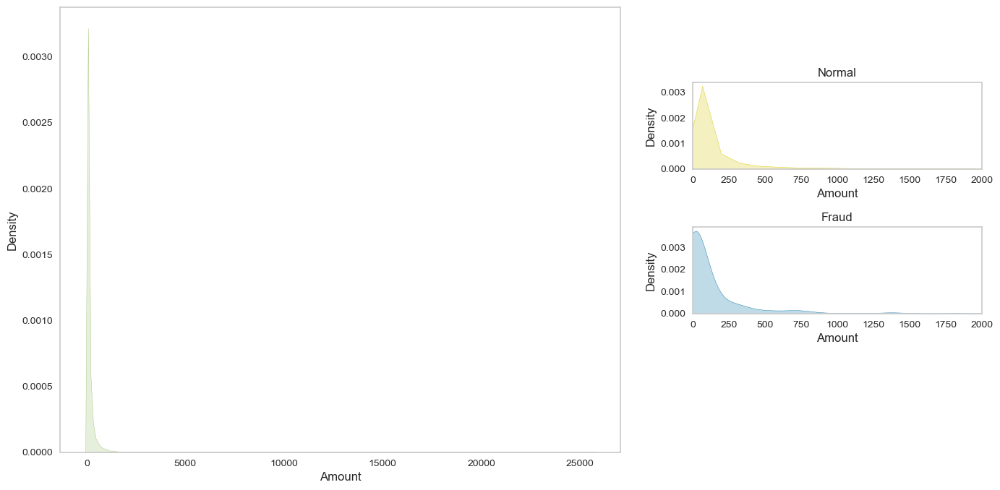

In [52]:
plt.figure(figsize = (10,8))
sns.set_style("whitegrid", {'axes.grid' : False})
sns.kdeplot(df['Amount'],shade=True, color ="g")
ax2 = plt.axes([1, 0.35, .4, .15], facecolor='w')
sns.kdeplot(data =df_fraud,  x = "Amount", shade= True );
ax2.set_title('Fraud')
ax2.set_xlim([0,2000]);
ax3 = plt.axes([1, 0.6, .4, .15], facecolor='w')
sns.kdeplot(data =df_nonfraud,  x = "Amount",color= "y", shade= True );
ax3.set_title('Normal')
ax3.set_xlim([0,2000]);

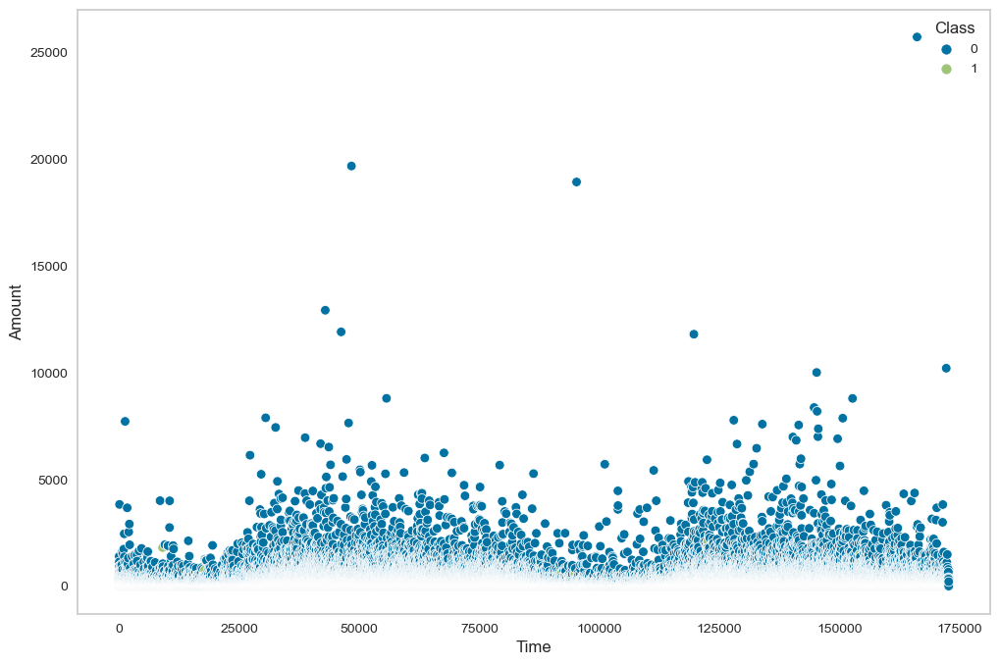

In [53]:
fig = plt.figure(figsize=(12, 8))

sns.scatterplot(data=df, x='Time', y='Amount',hue="Class")
plt.show()

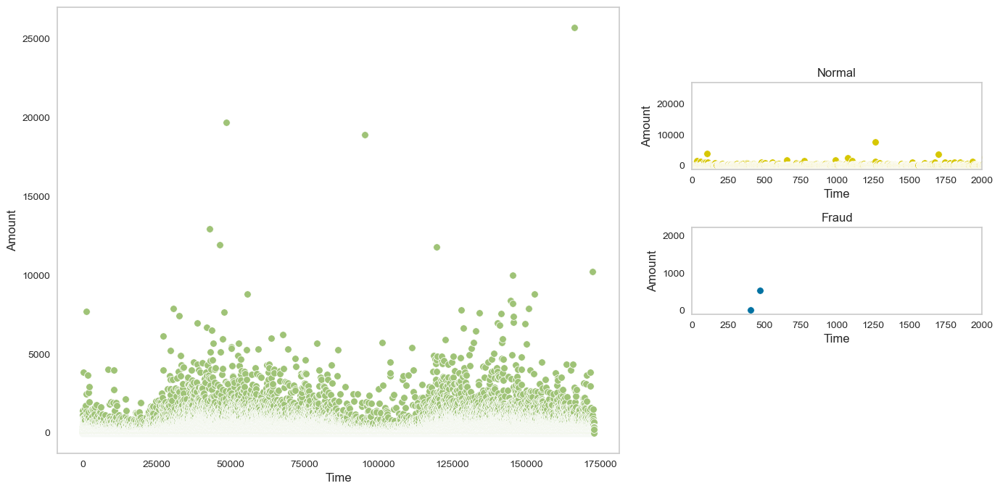

In [54]:
plt.figure(figsize = (10,8))
sns.set_style("whitegrid", {'axes.grid' : False})
sns.scatterplot(x = df["Time"],y =df['Amount'],  color ="g")
ax2 = plt.axes([1, 0.35, .4, .15], facecolor='w')
sns.scatterplot(data =df_fraud,  x = "Time", y = "Amount" );
ax2.set_title('Fraud')
ax2.set_xlim([0,2000]);
ax3 = plt.axes([1, 0.6, .4, .15], facecolor='w')
sns.scatterplot(data =df_nonfraud,  x ="Time" , y ="Amount" ,color= "y", );
ax3.set_title('Normal')
ax3.set_xlim([0,2000]);

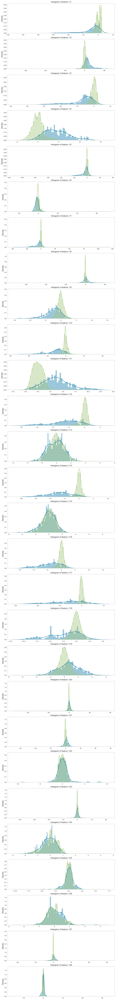

In [55]:
v_features = df.iloc[:,1:29].columns
plt.figure(figsize=(12,28*4))
gs = gridspec.GridSpec(28, 1)
for i, cn in enumerate(df[v_features]):
    ax = plt.subplot(gs[i])
    sns.distplot(df[cn][df.Class == 1], bins=50)
    sns.distplot(df[cn][df.Class == 0], bins=50)
    ax.set_xlabel('')
    ax.set_title('histogram of feature: ' + str(cn))
plt.show()

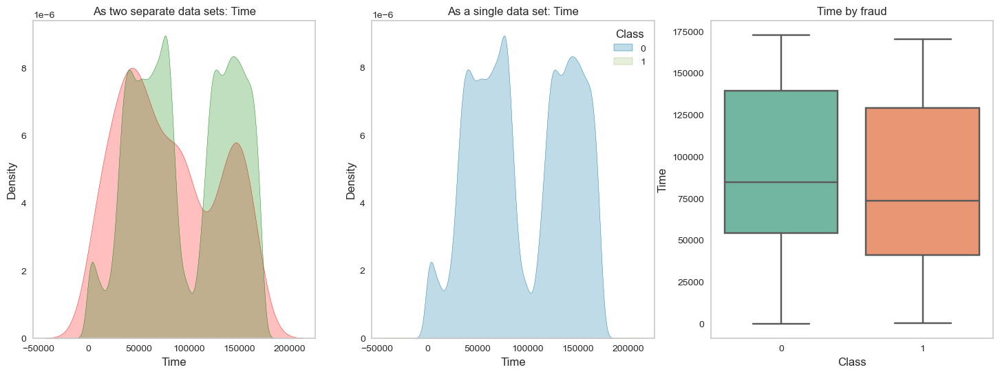

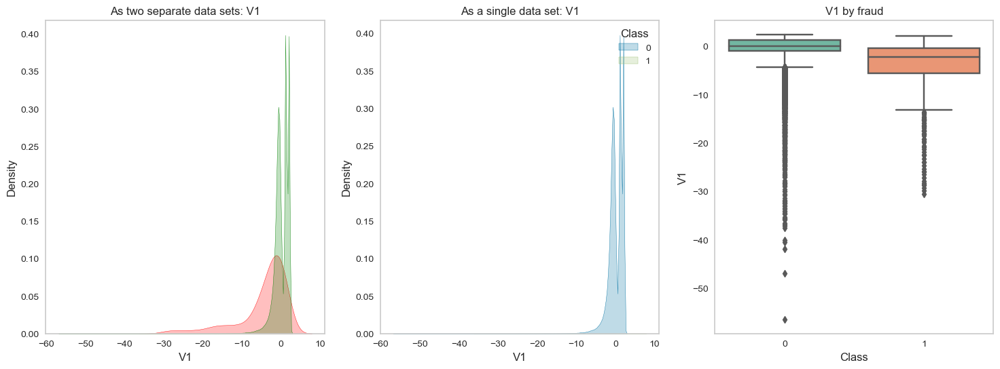

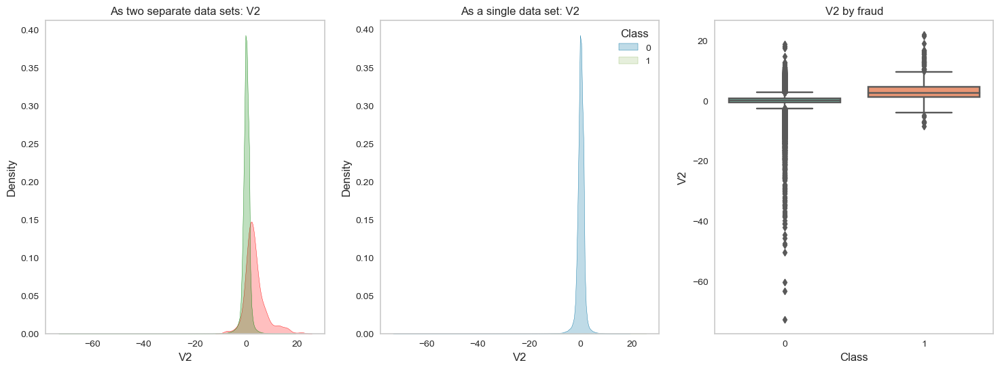

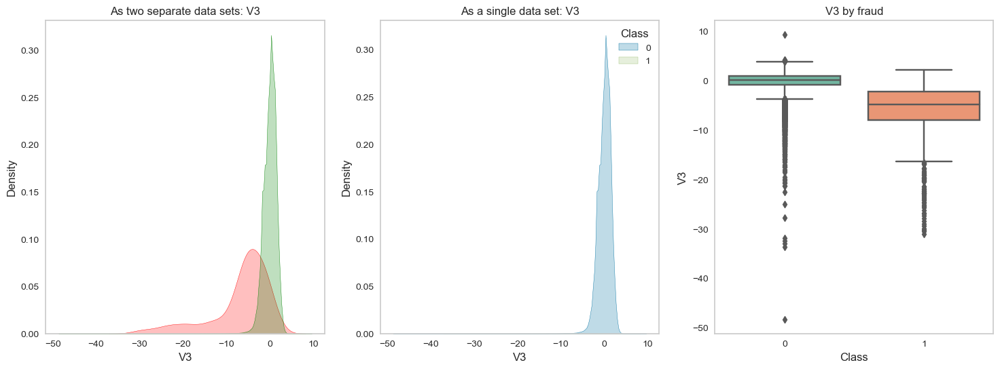

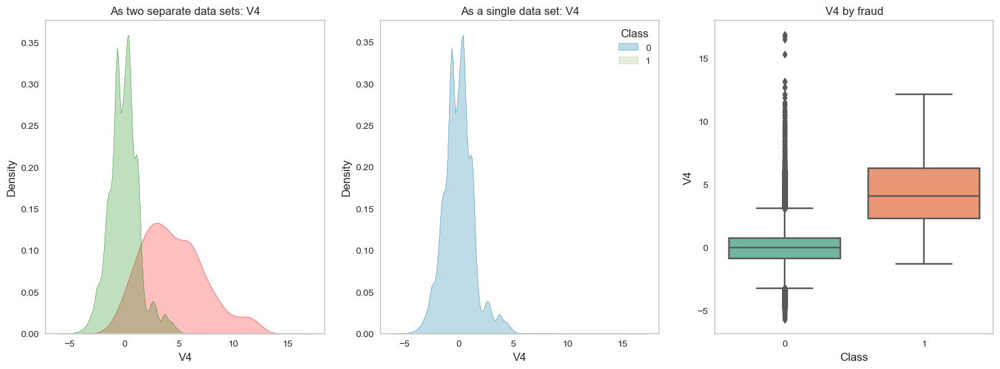

...

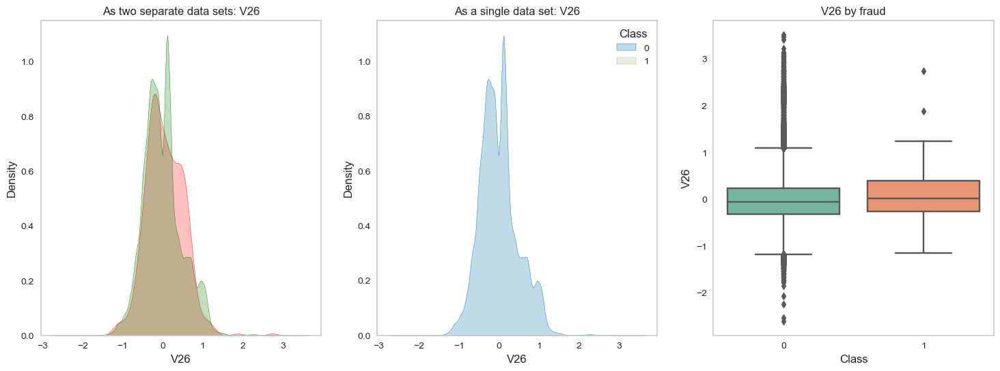

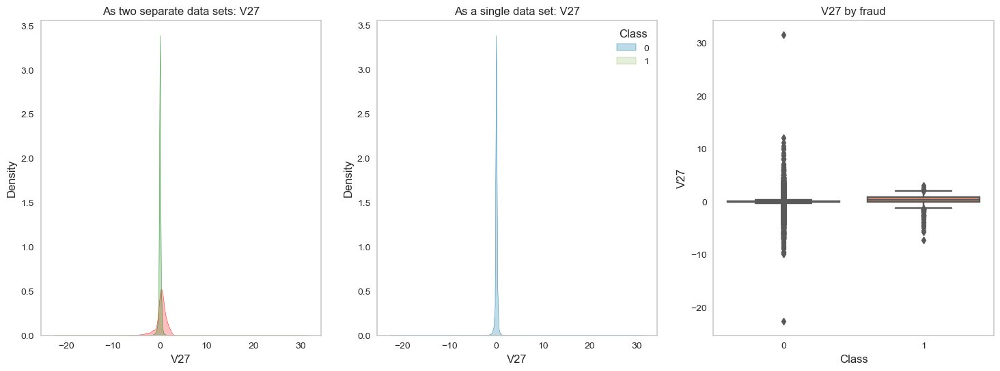

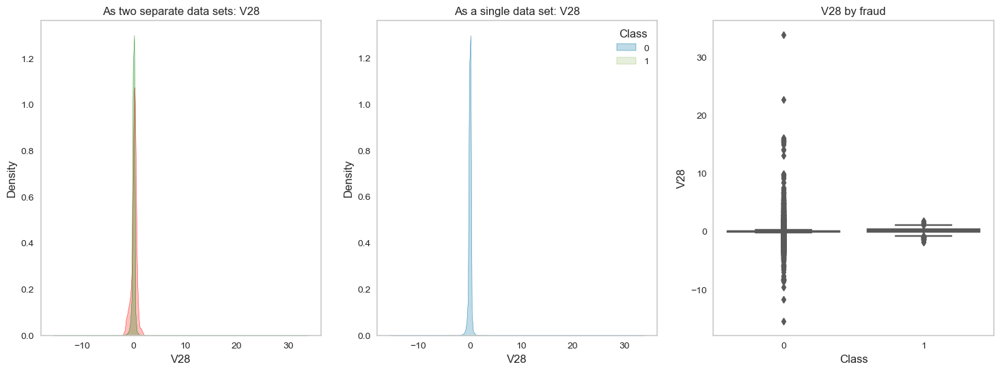

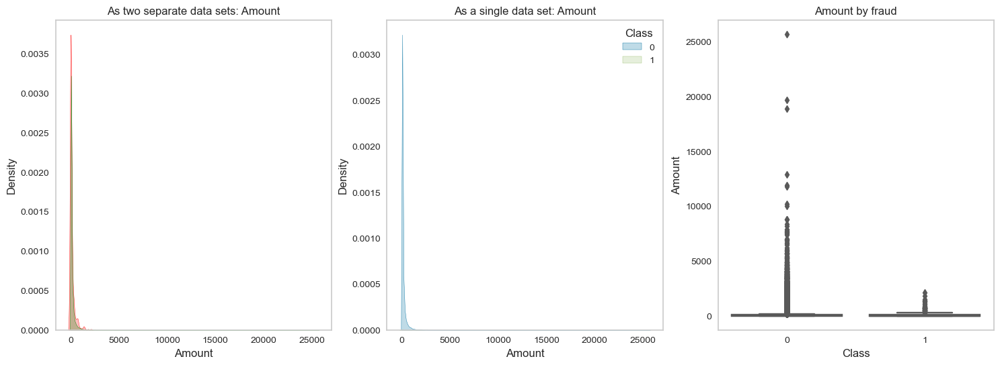

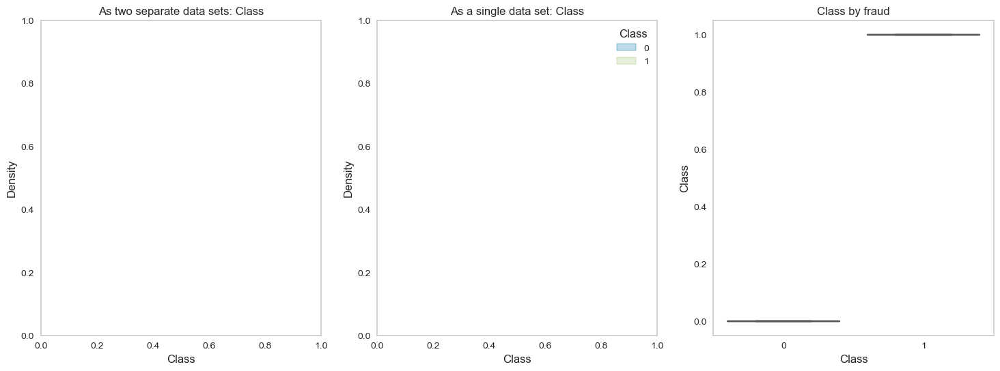

In [56]:
def numerical_column_investigation(col_name):
    f, ax = plt.subplots(1, 3, figsize=(18, 6))
    ax[0].set_title(f'As two separate data sets: {col_name}')
    sns.kdeplot(df_fraud[col_name], label='Fraud', ax=ax[0], shade=True, color='red')
    sns.kdeplot(df_nonfraud[col_name], label='Non-Fraud', ax=ax[0], shade=True, color='green')
    
    ax[1].set_title(f'As a single data set: {col_name}')
    sns.kdeplot(data=df, x=col_name, hue='Class', ax=ax[1], shade=True)
    
    ax[2].set_title(f'{col_name} by fraud')
    sns.boxplot(y=col_name, x='Class', data=df, palette='Set2', ax=ax[2]) 

# Tüm sütunlara fonksiyonu uygula
for column in df.columns:
    numerical_column_investigation(column)
    plt.show()

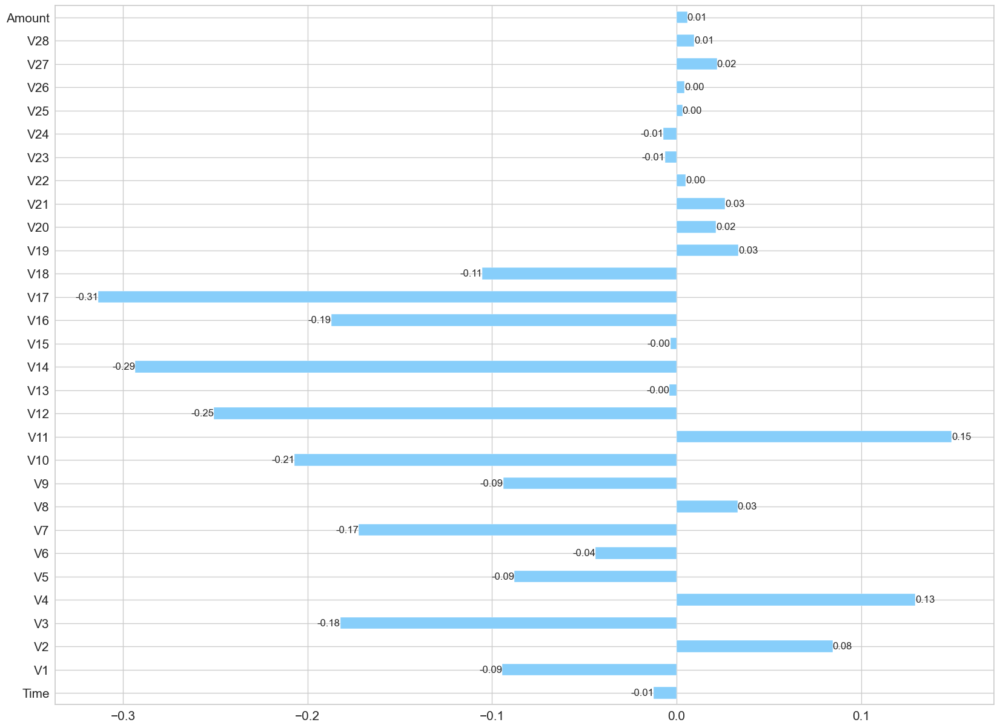

In [57]:
sns.set_style("whitegrid", {'axes.grid' : False})
ax = df.drop(columns = ['Class']).corrwith(df.Class).plot.barh(
        figsize = (20, 15), fontsize = 15, grid = True, color = "lightskyblue")
ax.bar_label(ax.containers[0], fmt='%.2f');

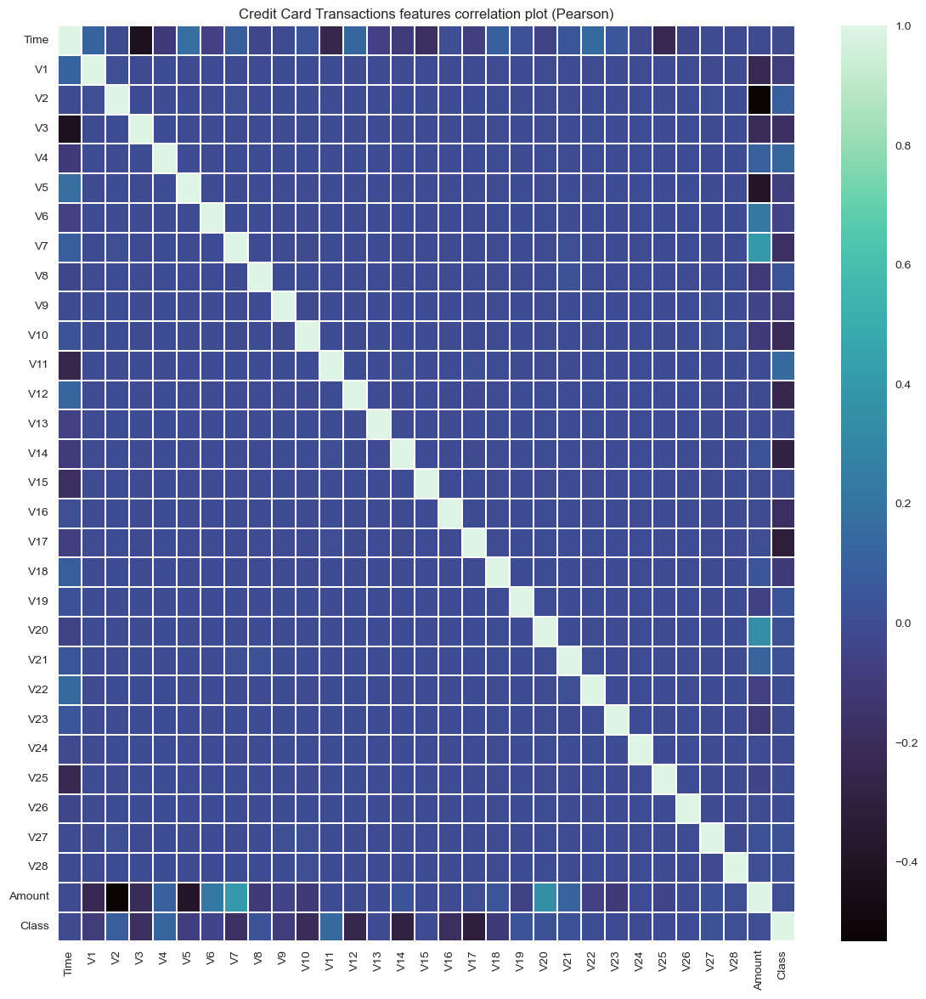

In [58]:
plt.figure(figsize = (14,14))
plt.title('Credit Card Transactions features correlation plot (Pearson)')
corr = df.corr()
sns.heatmap(corr,xticklabels=corr.columns,yticklabels=corr.columns,linewidths=.1,cmap="mako")
plt.show()

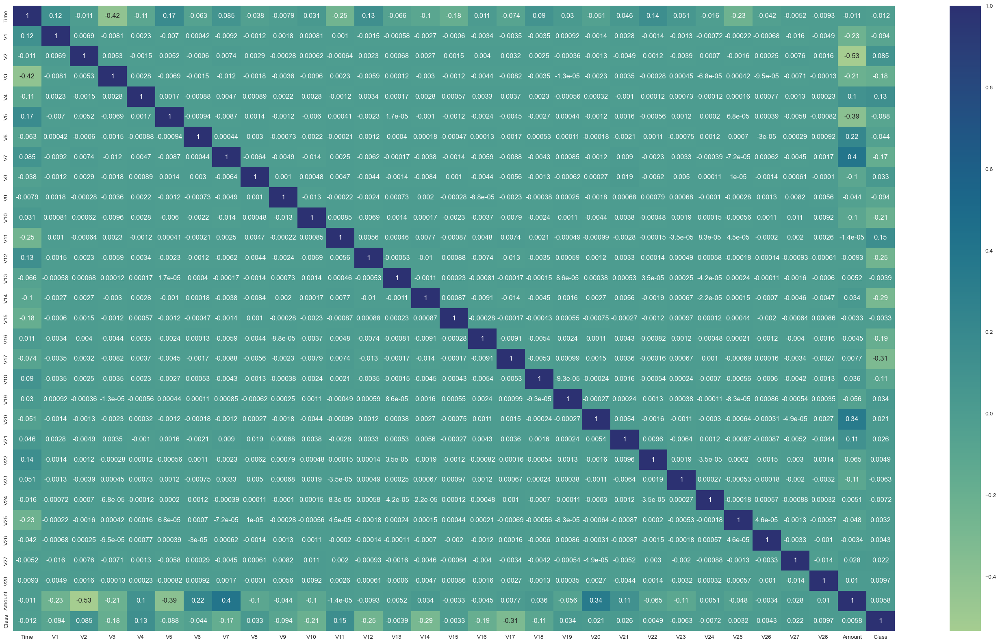

In [59]:
plt.figure(figsize=(35,20))
sns.heatmap(df.corr(),annot=True,cmap="crest")
plt.show()

In [60]:
from termcolor import cprint

def multicolinearity_control(df):                    
    df_temp = df.corr()
    count = 'Done'
    feature =[]
    collinear= []
    for col in df_temp.columns:
        for i in df_temp.index:
            if abs(df_temp[col][i] > .6 and df_temp[col][i] < 1):
                    feature.append(col)
                    collinear.append(i)
                    cprint(f"Multicolinearity alert in between --> {col} - {i} --> {round(df_temp[col][i], 6)}", "red", attrs=["bold"])
    else:
        cprint(f"There is NO multicollinearity problem.", "blue", attrs=["bold"])
        pass

In [61]:
df_numeric = df.select_dtypes("number")

In [62]:
multicolinearity_control(df_numeric)

There is NO multicollinearity problem.


### Data Cleaning
Check Missing Values and Outliers

In [63]:
df.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [64]:
df.duplicated().sum()

0

In [65]:
# OUTLIERS

iqr_factor = [1.5, 2, 3.5]
list1, list2 = [], []

for factor in iqr_factor:
    count = 0
    print(f'Outliers for {factor} IQR :')
    print('-------------------------------------')
    for col in df.select_dtypes(['int64', 'float64']):
    
        IQR = df[col].quantile(0.75) - df[col].quantile(0.25)
        lower_lim = df[col].quantile(0.25) - factor*IQR
        upper_lim = df[col].quantile(0.75) + factor*IQR
    
        cond = df[(df[col] < lower_lim) | (df[col] > upper_lim)].shape[0]
        
        if cond > 0 and factor == 1.5:
            list1.append(df[(df[col] < lower_lim) | (df[col] > upper_lim)].index.tolist())
        elif cond > 0 and factor == 2:
            list2.append(df[(df[col] < lower_lim) | (df[col] > upper_lim)].index.tolist())
        elif cond > 0 and factor == 3.5:
            list2.append(df[(df[col] < lower_lim) | (df[col] > upper_lim)].index.tolist())
        
        if cond > 0: print(f'{col:<10} : ', cond); count += cond
    print(f'\n{Fore.BLUE}TOTAL OUTLIERS FOR {factor} IQR : {count}{Style.RESET_ALL}')
    print('')

Outliers for 1.5 IQR :
-------------------------------------
V1         :  6948
V2         :  13390
V3         :  3305
V4         :  11094
V5         :  12220
V6         :  22886
V7         :  8839
V8         :  23902
V9         :  8199
V10        :  9346
V11        :  735
V12        :  15282
V13        :  3361
V14        :  14059
V15        :  2884
V16        :  8180
V17        :  7353
V18        :  7469
V19        :  10150
V20        :  27552
V21        :  14401
V22        :  1298
V23        :  18467
V24        :  4758
V25        :  5333
V26        :  5664
V27        :  38799
V28        :  30093
Amount     :  31685
Class      :  473

TOTAL OUTLIERS FOR 1.5 IQR : 368125

Outliers for 2 IQR :
-------------------------------------
V1         :  4342
V2         :  8872
V3         :  1764
V4         :  4750
V5         :  5985
V6         :  18953
V7         :  5725
V8         :  17097
V9         :  2915
V10        :  5624
V11        :  312
V12        :  8214
V13        :  403
V14        : 

In [66]:
def IQR_method (df,n,df_numeric):
    """
    Takes a dataframe and returns an index list corresponding to the observations 
    containing more than n outliers according to the Tukey IQR method.
    """
    outlier_list = []
    
    for column in df_numeric:
                
        # 1st quartile (25%)
        Q1 = np.percentile(df[column], 25)
        # 3rd quartile (75%)
        Q3 = np.percentile(df[column],75)
        
        # Interquartile range (IQR)
        IQR = Q3 - Q1
        
        # outlier step
        outlier_step = 3.5 * IQR
        
        # Determining a list of indices of outliers
        outlier_list_column = df[(df[column] < Q1 - outlier_step) | (df[column] > Q3 + outlier_step )].index
        
        # appending the list of outliers 
        outlier_list.extend(outlier_list_column)
        
    # selecting observations containing more than x outliers
    outlier_list = Counter(outlier_list)        
    multiple_outliers = list( k for k, v in outlier_list.items() if v > n )
    
    # Calculate the number of records below and above lower and above bound value respectively
    df1 = df[df[column] < Q1 - outlier_step]
    df2 = df[df[column] > Q3 + outlier_step]
    
    print('Total number of outliers is:', df1.shape[0]+df2.shape[0])
    
    return multiple_outliers

In [67]:
Outliers_IQR = IQR_method(df,1,df_numeric)

Total number of outliers is: 473


In [68]:
df_without_out = df.drop(Outliers_IQR, axis = 0).reset_index(drop=True)

In [69]:
df_without_out.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 263775 entries, 0 to 263774
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    263775 non-null  float64
 1   V1      263775 non-null  float64
 2   V2      263775 non-null  float64
 3   V3      263775 non-null  float64
 4   V4      263775 non-null  float64
 5   V5      263775 non-null  float64
 6   V6      263775 non-null  float64
 7   V7      263775 non-null  float64
 8   V8      263775 non-null  float64
 9   V9      263775 non-null  float64
 10  V10     263775 non-null  float64
 11  V11     263775 non-null  float64
 12  V12     263775 non-null  float64
 13  V13     263775 non-null  float64
 14  V14     263775 non-null  float64
 15  V15     263775 non-null  float64
 16  V16     263775 non-null  float64
 17  V17     263775 non-null  float64
 18  V18     263775 non-null  float64
 19  V19     263775 non-null  float64
 20  V20     263775 non-null  float64
 21  V21     26

In [70]:
def plot_histograms(df):
    num_columns = len(df.columns)
    num_plots = num_columns // 3 + int(num_columns % 3 > 0)  # Toplam alt grafik sayısı
    fig, axes = plt.subplots(nrows=num_plots, ncols=3, figsize=(18, 6 * num_plots))
    fig.tight_layout(pad=4.0)

    for i, column in enumerate(df.columns):
        row = i // 3
        col = i % 3
        ax = axes[row, col]  
        ax.hist(df[column], bins=50)
        ax.set_xlabel(column)
        ax.set_ylabel('Count')
        ax.set_title(f'Histogram of {column}')

    plt.show()

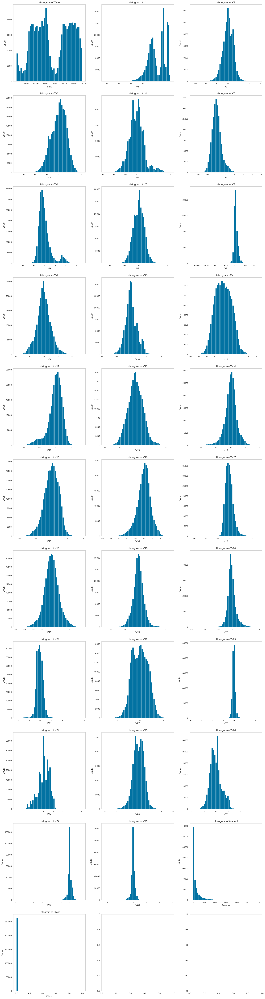

In [71]:
plot_histograms(df_without_out)

In [72]:
def plot_boxplots(df):
    num_columns = len(df.columns)
    num_plots = num_columns // 3 + int(num_columns % 3 > 0)  # Total number of subplots
    fig, axes = plt.subplots(nrows=num_plots, ncols=3, figsize=(18, 6 * num_plots))
    fig.tight_layout(pad=4.0)

    for i, column in enumerate(df.columns):
        row = i // 3
        col = i % 3
        ax = axes[row, col]
        ax.boxplot(df[column])
        ax.set_xlabel(column)
        ax.set_ylabel('Value')
        ax.set_title(f'Boxplot of {column}')


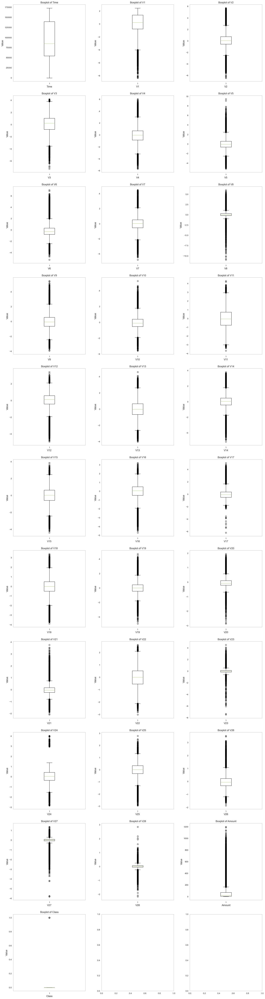

In [73]:
plot_boxplots(df_without_out)

## 2. Data Preprocessing

#### Train - Test Split

In [74]:
from deepchecks.tabular import Dataset
ds =  Dataset(df, label="Class", cat_features=[])

In [75]:
from deepchecks.tabular.suites import data_integrity

# Run Suite:
integ_suite = data_integrity()
suite_result = integ_suite.run(ds)
# Note: the result can be saved as html using suite_result.save_as_html()
# or exported to json using suite_result.to_json()
suite_result.show()

Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_7ZM1W5ELPBF1GUE4HEJ75H2LS">Data Integrity Sui…

In [76]:
X = df.drop(['Time','Class'], axis=1)
y = df['Class']

In [77]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

In [78]:
y_train.value_counts(), y_test.value_counts()

(0    226600
 1       378
 Name: Class, dtype: int64,
 0    56650
 1       95
 Name: Class, dtype: int64)

In [79]:
y_train.value_counts(normalize=True), y_test.value_counts(normalize=True)

(0    0.998335
 1    0.001665
 Name: Class, dtype: float64,
 0    0.998326
 1    0.001674
 Name: Class, dtype: float64)

## Train-Test Validation Checks
* link : https://docs.deepchecks.com/stable/user-guide/tabular/auto_quickstarts/plot_quick_train_test_validation.html

In [80]:
from deepchecks.tabular import Dataset

train_ds = Dataset(X_train, label=y_train, cat_features=[])
test_ds = Dataset(X_test, label=y_test, cat_features=[])

In [81]:
from deepchecks.tabular.suites import train_test_validation

res = train_test_validation().run(train_ds, test_ds) #result
res

Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_NKK8B85G1UGTC9YSUUV2HUOY1">Train Test Validat…

#### Scaling

---
---


## 3. Model Building
It was previously stated that you need to make class prediction with four different algorithms. As in this case, different approaches are required to obtain better performance on unbalanced data.

This dataset is severely **unbalanced** (most of the transactions are non-fraud). So the algorithms are much more likely to classify new observations to the majority class and high accuracy won't tell us anything. To address the problem of imbalanced dataset, we can use undersampling and oversampling or class weight and optimum thresold techniques. 

#### First, we check vanilla ML models 

In [83]:
scaler = RobustScaler()
X_train = scaler.fit_transform(X_train)
X_test  = scaler.transform(X_test)


models = []
models.append(("XGB",XGBClassifier(random_state = 42)))
models.append(('RF', RandomForestClassifier(random_state = 42)))
models.append(('LR', LogisticRegression(random_state = 42)))


name_list = []
accuracy_scores = []
accuracy_scores_train = []
recall_scores = []
recall_scores_train = []
f1_scores = []
f1_scores_train = []



for name,model in models:
    model.fit(X_train,y_train)
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)
    accuracy_scores.append(accuracy_score(y_test,y_pred))
    accuracy_scores_train.append(accuracy_score(y_train,y_pred_train))
    recall_scores.append(recall_score(y_test,y_pred))
    recall_scores_train.append(recall_score(y_train,y_pred_train))
    f1_scores.append(f1_score(y_test,y_pred))
    f1_scores_train.append(f1_score(y_train,y_pred_train))
    name_list.append(name)
    result = {"Model":name_list,"Accuracy Score Test":accuracy_scores, "Accuracy Score Train": accuracy_scores_train,\
              "Recall Score Test":recall_scores, "Recall Score Train": recall_scores_train ,\
              "F1 Score Test" :f1_scores,"F1 Score train" : f1_scores_train}    
     
dataframe = pd.DataFrame(result).sort_values(by="F1 Score Test",ascending=False)
dataframe.reset_index(drop=True)

,Model,Accuracy Score Test,Accuracy Score Train,Recall Score Test,Recall Score Train,F1 Score Test,F1 Score train
0,XGB,0.999524,1.000000,0.736842,1.000000,0.838323,1.000000
1,RF,0.999507,1.000000,0.736842,1.000000,0.833333,1.000000
2,LR,0.999154,0.999216,0.578947,0.624339,0.696203,0.726154


### Logistic Regression 

- The steps you are going to cover for this algorithm are as follows: 

   *i. Import Libraries*
   
   *ii. Model Training*
   
   *iii. Prediction and Model Evaluating and Tuning*
   
   *iv. Plot Precision and Recall Curve*

***i. Import Libraries***

In [84]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, ConfusionMatrixDisplay

In [85]:
def eval_metric(model, X_train, y_train, X_test, y_test):
    
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)
    
    print("Test_Set")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))
    print()
    print("Train_Set")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred))

***ii. Model Training***

In [86]:
from deepchecks.tabular.suites import model_evaluation


operations = [("Scaler", RobustScaler()), 
              ("log", LogisticRegression(class_weight="balanced", 
                                         random_state=42))]

pipeline_log_balanced = Pipeline(steps=operations)
pipeline_log_balanced.fit(X_train, y_train)

Pipeline(steps=[('Scaler', RobustScaler()),
                ('log',
                 LogisticRegression(class_weight='balanced', random_state=1))])

In [87]:
result = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=pipeline_log_balanced)
result

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 16 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_HXXJ3M2BKBO1C8QPI872GMY03">Model Evaluation S…

In [88]:
eval_metric(pipeline_log_balanced, X_train, y_train, X_test, y_test)

Test_Set
[[55265  1385]
 [   12    83]]
              precision    recall  f1-score   support

           0       1.00      0.98      0.99     56650
           1       0.06      0.87      0.11        95

    accuracy                           0.98     56745
   macro avg       0.53      0.92      0.55     56745
weighted avg       1.00      0.98      0.99     56745


Train_Set
[[221107   5493]
 [    30    348]]
              precision    recall  f1-score   support

           0       1.00      0.98      0.99    226600
           1       0.06      0.92      0.11       378

    accuracy                           0.98    226978
   macro avg       0.53      0.95      0.55    226978
weighted avg       1.00      0.98      0.99    226978



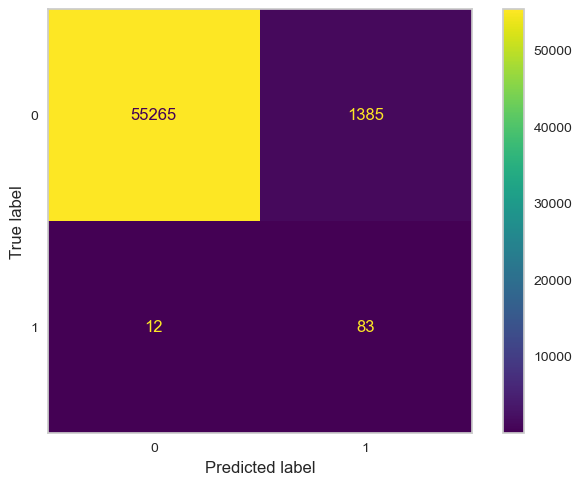

In [89]:
ConfusionMatrixDisplay.from_estimator(pipeline_log_balanced, X_test, y_test);

In [90]:
operations = [("Scaler", RobustScaler()), 
              ("log", LogisticRegression(class_weight={1:5,0:0.5},
                                         #tried various class weights and decided to this
                                         random_state=42))]

pipeline_log = Pipeline(steps=operations)
pipeline_log.fit(X_train, y_train)

Pipeline(steps=[('Scaler', RobustScaler()),
                ('log',
                 LogisticRegression(class_weight={0: 0.5, 1: 5},
                                    random_state=1))])

In [93]:
y_pred = pipeline_log.predict(X_test)
pipeline_log_f1 = f1_score(y_test, y_pred)
pipeline_log_recall = recall_score(y_test, y_pred)
pipeline_log_ap = average_precision_score(y_test, y_pred)

In [94]:
result = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=pipeline_log)
result

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 14 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_R8L6AWWFDI2FY23VS93MRXCH0">Model Evaluation S…

In [95]:
eval_metric(pipeline_log, X_train, y_train, X_test, y_test)

Test_Set
[[56631    19]
 [   21    74]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.80      0.78      0.79        95

    accuracy                           1.00     56745
   macro avg       0.90      0.89      0.89     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226503     97]
 [    64    314]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.76      0.83      0.80       378

    accuracy                           1.00    226978
   macro avg       0.88      0.92      0.90    226978
weighted avg       1.00      1.00      1.00    226978



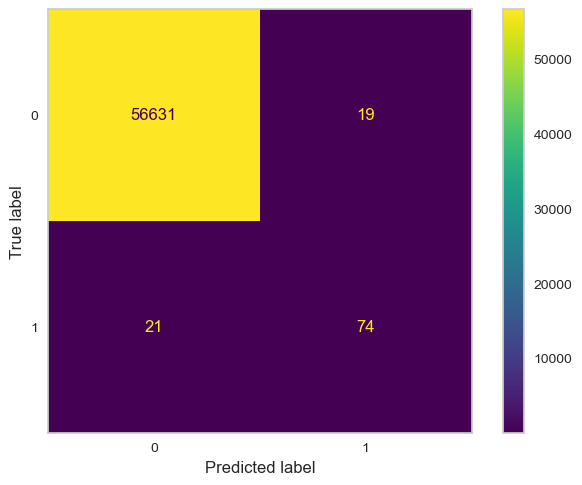

In [96]:
ConfusionMatrixDisplay.from_estimator(pipeline_log, X_test, y_test);

#### Cross Validation

In [97]:
model = Pipeline(steps = operations)
scores = cross_validate(model, X_train, y_train, scoring = ['precision','recall','f1'], cv = 10 ,return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_precision     0.766540
train_precision    0.762899
test_recall        0.820199
train_recall       0.829219
test_f1            0.789674
train_f1           0.794664
dtype: float64

In [98]:
result = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=model)
result

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 25 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_X59V9APW42F9FUELPW363QYIS">Model Evaluation S…

#### Grid Search

In [99]:
scoring = {"precision_1" : make_scorer(precision_score, average = None, labels =[1]),
           "recall_1" : make_scorer(recall_score, average = None, labels =[1]),
           "f1_1" : make_scorer(f1_score, average = None, labels =[1])}

In [100]:
operations = [("Scaler", RobustScaler()), 
              ("log", LogisticRegression(class_weight={1:5,0:0.5},
                                        
                                         random_state=42))]
model = Pipeline(operations)

penalty = ["l1", "l2"]
C = [0.01, 0.5, 1, 5]
solver = ['liblinear', 'lbfgs']
scoring=make_scorer(recall_score, average=None, labels=[1])

param_grid = {"log__penalty" : penalty,
             "log__C" : C,
             "log__solver" : solver}

log_grid_model = GridSearchCV(model, param_grid = param_grid, scoring=scoring, cv=10, n_jobs=-1)

In [101]:
operations = [("log_grid_model", LogisticRegression(class_weight={1:5,0:5},
                                                    max_iter=10000,
                                                    random_state=42,
                                                    penalty = "l1",
                                                    C = 0.5,
                                                    solver="liblinear"))]

In [102]:
log_grid_model = Pipeline(steps=operations)
log_grid_model.fit(X_train, y_train)

Pipeline(steps=[('log_grid_model',
                 LogisticRegression(C=0.5, class_weight={0: 5, 1: 5},
                                    max_iter=10000, penalty='l1',
                                    random_state=42, solver='liblinear'))])

In [103]:
eval_metric(log_grid_model, X_train, y_train, X_test, y_test)

Test_Set
[[56642     8]
 [   40    55]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.87      0.58      0.70        95

    accuracy                           1.00     56745
   macro avg       0.94      0.79      0.85     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226564     36]
 [   142    236]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.87      0.62      0.73       378

    accuracy                           1.00    226978
   macro avg       0.93      0.81      0.86    226978
weighted avg       1.00      1.00      1.00    226978



In [104]:
y_pred = log_grid_model.predict(X_test)
log_grid_model_f1 = f1_score(y_test, y_pred)
log_grid_model_recall = recall_score(y_test, y_pred)
log_grid_model_ap = average_precision_score(y_test, y_pred)

In [105]:
#log_grid_model.fit(X_train, y_train)

In [106]:
#log_grid_model.best_estimator_

In [107]:
#log_grid_model.best_params_

In [108]:
#log_grid_model.best_score_

In [109]:
#eval_metric(log_grid_model, X_train, y_train, X_test, y_test)

In [110]:
#ConfusionMatrixDisplay.from_estimator(log_grid_model, X_test, y_test);

### Logistic Regression with Unbalanced Data Techniques

#### Feature Selection with Shap

In [111]:
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [112]:
pipeline_log_shap = LogisticRegression(class_weight={0: 0.5, 1: 5}, 
                                       random_state=42, 
                                       penalty='l1', 
                                       C=0.5, solver="liblinear")
pipeline_log_shap.fit(X_train_scaled, y_train)

LogisticRegression(C=0.5, class_weight={0: 0.5, 1: 5}, penalty='l1',
                   random_state=42, solver='liblinear')

In [113]:
eval_metric(pipeline_log_shap, X_train, y_train, X_test, y_test)

Test_Set
[[56631    19]
 [   21    74]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.80      0.78      0.79        95

    accuracy                           1.00     56745
   macro avg       0.90      0.89      0.89     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226503     97]
 [    65    313]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.76      0.83      0.79       378

    accuracy                           1.00    226978
   macro avg       0.88      0.91      0.90    226978
weighted avg       1.00      1.00      1.00    226978



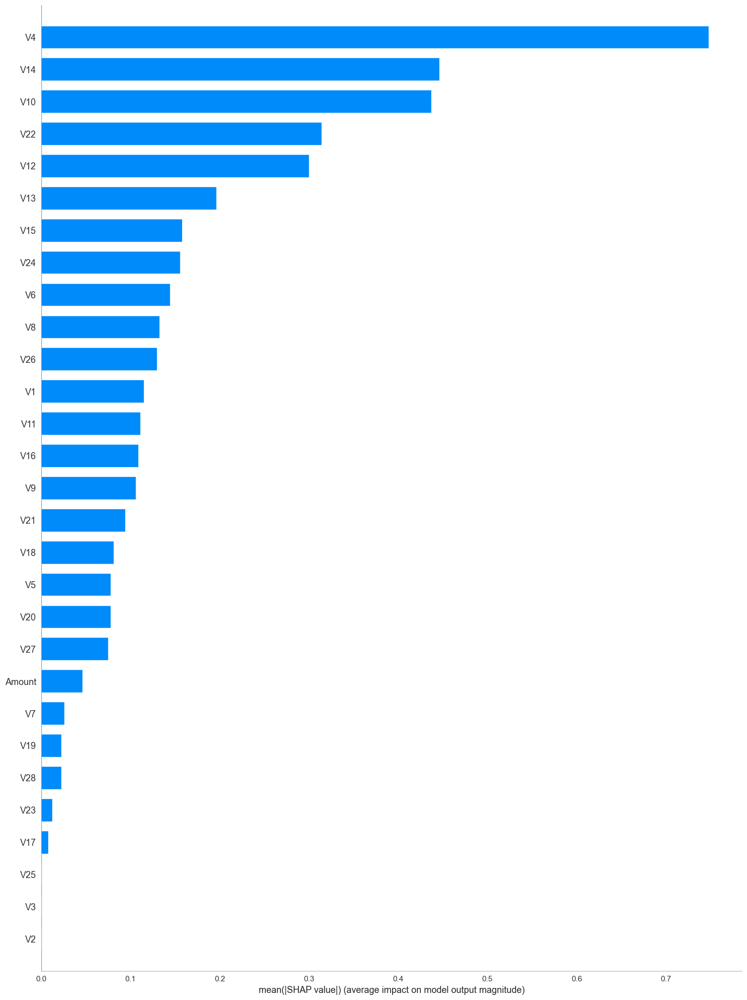

In [114]:
explainer = shap.LinearExplainer(pipeline_log_shap, X_train_scaled) #LinearExplainer

shap_values = explainer.shap_values(X_test_scaled)

shap.summary_plot(shap_values,  max_display=300, feature_names = X.columns,plot_type = "bar", plot_size=(15,20))

In [115]:
fraud=["V4",  'V14',  'V10', "V22", 'V12'] ## we choose the top 5 features

In [116]:
X2 = X[fraud]
X2.head()

,V4,V14,V10,V22,V12
0,1.378155,-0.311169,0.090794,0.277838,-0.617801
1,0.448154,-0.143772,-0.166974,-0.638672,1.065235
2,0.379780,-0.165946,0.207643,0.771679,0.066084
3,-0.863291,-0.287924,-0.054952,0.005274,0.178228
4,0.403034,-1.119670,0.753074,0.798278,0.538196


In [117]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y, test_size=0.2, stratify=y, random_state=42)

In [118]:
operations_shap = [("log_model", LogisticRegression(class_weight={0: 0.5, 1: 5}, 
                                       random_state=42, 
                                       penalty='l1', 
                                       C=0.5, solver="liblinear"))]

***iii. Prediction and Model Evaluating  and Tuning***

In [119]:
pipe_shap_model = Pipeline(steps=operations_shap)
pipe_shap_model.fit(X_train2, y_train2)

Pipeline(steps=[('log_model',
                 LogisticRegression(C=0.5, class_weight={0: 0.5, 1: 5},
                                    penalty='l1', random_state=42,
                                    solver='liblinear'))])

In [120]:
eval_metric(pipe_shap_model, X_train2, y_train2, X_test2, y_test2)

Test_Set
[[56624    26]
 [   22    73]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.74      0.77      0.75        95

    accuracy                           1.00     56745
   macro avg       0.87      0.88      0.88     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226486    114]
 [    68    310]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.73      0.82      0.77       378

    accuracy                           1.00    226978
   macro avg       0.87      0.91      0.89    226978
weighted avg       1.00      1.00      1.00    226978




You're evaluating "accuracy score"? Is your performance metric reflect real success? You may need to use different metrics to evaluate performance on unbalanced data. You should use **[precision and recall metrics](https://scikit-learn.org/stable/auto_examples/model_selection/plot_precision_recall.html#:~:text=The%20precision%2Drecall%20curve%20shows,a%20low%20false%20negative%20rate.)**.

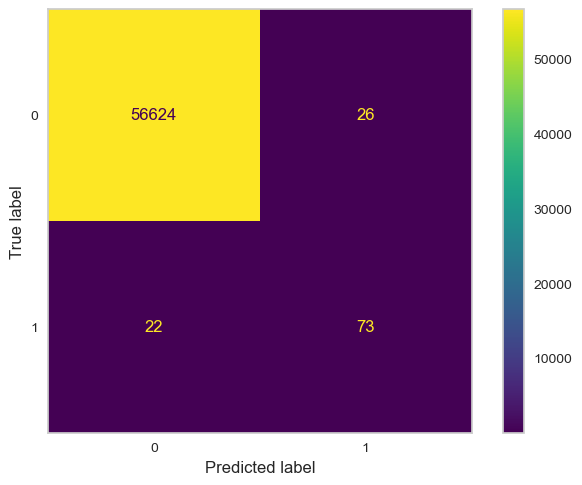

In [121]:
ConfusionMatrixDisplay.from_estimator(pipe_shap_model, X_test2, y_test2);

### CV for Shap

In [122]:
model = Pipeline(steps=operations_shap)
scoring=make_scorer(recall_score, average=None, labels=[1])

scores = cross_validate(model, 
                        X_train2,
                        y_train2, 
                        scoring=scoring,
                        cv=10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_score     0.820199
train_score    0.819813
dtype: float64

***iv. Plot Precision and Recall Curve***


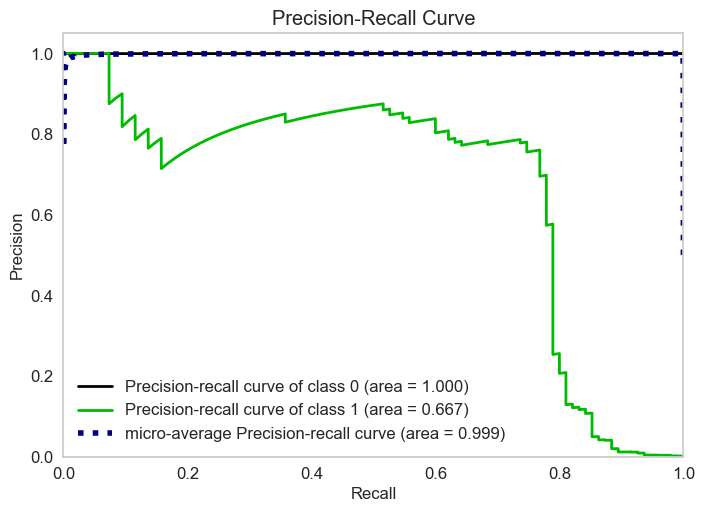

In [123]:
model = Pipeline(steps=operations_shap)

model.fit(X_train2, y_train2)

y_pred_proba = model.predict_proba(X_test2)
    
plot_precision_recall(y_test2, y_pred_proba)
plt.show();

In [124]:
y_pred = pipe_shap_model.predict(X_test2)

log_precision = precision_score(y_test2, y_pred, labels=["Class"])
log_recall = recall_score(y_test2, y_pred, labels=["Class"])
log_f1 = f1_score(y_test2, y_pred, labels=["Class"])

##we save the model for comparison

In [125]:
y_pred = pipe_shap_model.predict(X_test2)
matthews_corrcoef(y_test2, y_pred)

0.7523143098016063

In [126]:
list(pipe_shap_model.feature_names_in_)

['V4', 'V14', 'V10', 'V22', 'V12']

***v. Apply Model Evaluation Checks***
* link : https://docs.deepchecks.com/stable/user-guide/tabular/auto_quickstarts/plot_quick_model_evaluation.html

In [127]:
train_ds = Dataset(X_train2, label=y_train, cat_features=[])
test_ds = Dataset(X_test2, label=y_test, cat_features=[])

In [129]:
res = model_evaluation().run(train_ds, test_ds, pipe_shap_model)
res

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 2 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_8SKR1OH1HNY9QL6WBM0LKFMCN">Model Evaluation S…

### Logistic Regression with Unbalanced Data Techniques : SMOTE

***i. Train-Test Split (Again)***

In [130]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

In [131]:
y_train.value_counts()

0    226600
1       378
Name: Class, dtype: int64

In [132]:
over = SMOTE(sampling_strategy= 0.2, k_neighbors=9, random_state=42)
under = RandomUnderSampler(sampling_strategy=0.9, random_state=42)

In [133]:
steps = [('o', over), ('u', under)]
pipeline = imbpipeline(steps=steps)

X_resampled, y_resampled = pipeline.fit_resample(X_train, y_train)

In [134]:
y_resampled.value_counts()

0    50355
1    45320
Name: Class, dtype: int64

***ii. Model Training***

In [135]:
operations = [('o', over), ('u', under), ("scaler", RobustScaler()), 
              ("log", LogisticRegression(random_state=42, penalty='l1', C=0.002, solver='saga'))]

log_smote_model = imbpipeline(steps=operations)
log_smote_model.fit(X_train, y_train)

Pipeline(steps=[('o',
                 SMOTE(k_neighbors=9, random_state=1, sampling_strategy=0.2)),
                ('u',
                 RandomUnderSampler(random_state=1, sampling_strategy=0.9)),
                ('scaler', RobustScaler()),
                ('log',
                 LogisticRegression(C=0.002, penalty='l1', random_state=42,
                                    solver='saga'))])

In [136]:
eval_metric(log_smote_model, X_train, y_train, X_test, y_test)

Test_Set
[[56099   551]
 [   13    82]]
              precision    recall  f1-score   support

           0       1.00      0.99      0.99     56650
           1       0.13      0.86      0.23        95

    accuracy                           0.99     56745
   macro avg       0.56      0.93      0.61     56745
weighted avg       1.00      0.99      0.99     56745


Train_Set
[[224359   2241]
 [    42    336]]
              precision    recall  f1-score   support

           0       1.00      0.99      0.99    226600
           1       0.13      0.89      0.23       378

    accuracy                           0.99    226978
   macro avg       0.57      0.94      0.61    226978
weighted avg       1.00      0.99      0.99    226978



***iii. Prediction and Model Evaluating and Tuning***

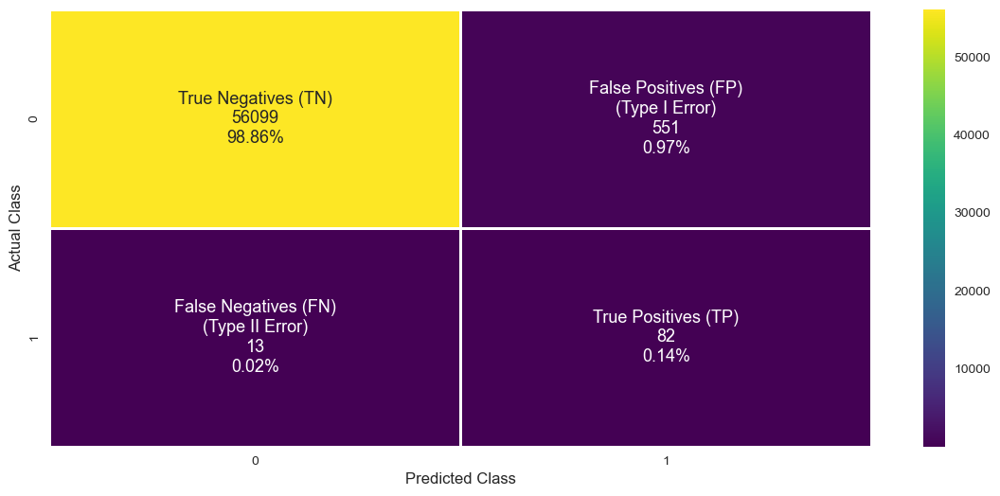

In [137]:
plt.figure(figsize=(14,6))

y_pred = log_smote_model.predict(X_test)
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ['True Negatives (TN)', 'False Positives (FP)\n(Type I Error)', 
               'False Negatives (FN)\n(Type II Error)', 'True Positives (TP)']
group_counts = ['{0:0.0f}'.format(value) for value in cf_matrix.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", annot_kws={'size': 13}, cmap='viridis', linewidth=1)
ax.set(xlabel='Predicted Class', ylabel = 'Actual Class');

In [138]:
pred_sample = y_test[y_test.values==1].sample(10, random_state=42)
pred_sample.values

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int64)

In [139]:
log_smote_model.predict(X_test.loc[pred_sample.index.tolist()])

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int64)

***iv.  Plot Precision and Recall Curve***


In [140]:
from yellowbrick.classifier import PrecisionRecallCurve
from sklearn.metrics import average_precision_score

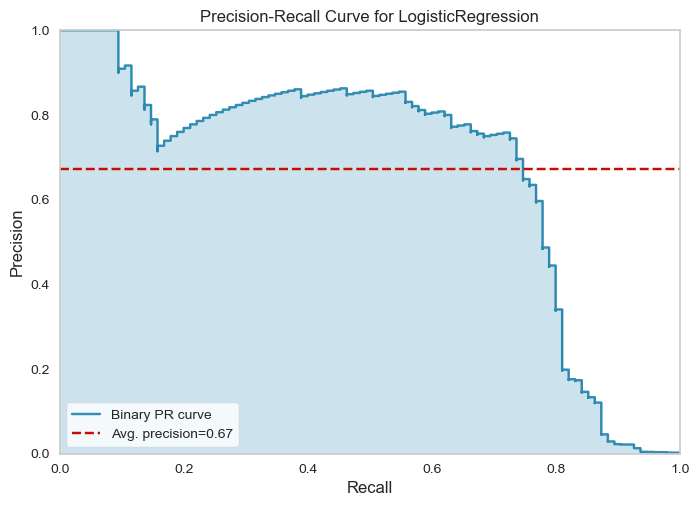

In [141]:
viz = PrecisionRecallCurve(log_smote_model)

viz.fit(X_train, y_train)
viz.score(X_test, y_test)
viz.show();

In [142]:
y_pred_proba = log_smote_model.predict_proba(X_test)
average_precision_score(y_test, y_pred_proba[:,1])

0.6718999876242233

In [143]:
y_pred = log_smote_model.predict(X_test)
log_smote_model_f1 = f1_score(y_test, y_pred)
log_smote_model_recall = recall_score(y_test, y_pred)
log_smote_model_ap = average_precision_score(y_test, y_pred)

***v. Apply Model Evaluation Checks***
* link : https://docs.deepchecks.com/stable/user-guide/tabular/auto_quickstarts/plot_quick_model_evaluation.html

In [144]:
from deepchecks.tabular.suites import model_evaluation

In [145]:
train_ds = Dataset(X_resampled, label=y_resampled, cat_features=[])
test_ds = Dataset(X_test, label=y_test, cat_features=[])

In [146]:
res_smote = model_evaluation().run(train_ds, test_ds, log_smote_model)
res_smote

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 15 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_9PIX8C47ASEHRJXOLRBHY7A27">Model Evaluation S…

### Random Forest Classifier with Unbalanced Data Techniques
   

### With SMOTE

#### i. Model Training

In [147]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify =y)

In [148]:
over = SMOTE(sampling_strategy=0.2)
under = RandomUnderSampler(sampling_strategy=0.9)

In [149]:
X_resampled_over, y_resampled_over = over.fit_resample(X_train, y_train)

In [150]:
class_weights = {0 : 1, 1 : 1}

In [151]:
rf_operations = [('o', over), ('u', under), ('rf', RandomForestClassifier(class_weight=class_weights, max_depth=7, random_state=42))]
smote_rf_model = imbpipeline(steps=rf_operations)

In [152]:
smote_rf_model.fit(X_train, y_train)

Pipeline(steps=[('o', SMOTE(sampling_strategy=0.2)),
                ('u', RandomUnderSampler(sampling_strategy=0.9)),
                ('rf',
                 RandomForestClassifier(class_weight={0: 1, 1: 1}, max_depth=7,
                                        random_state=42))])

In [153]:
eval_metric(smote_rf_model, X_train, y_train, X_test, y_test)

Test_Set
[[56501   149]
 [   16    79]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.35      0.83      0.49        95

    accuracy                           1.00     56745
   macro avg       0.67      0.91      0.74     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[225943    657]
 [    27    351]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.35      0.93      0.51       378

    accuracy                           1.00    226978
   macro avg       0.67      0.96      0.75    226978
weighted avg       1.00      1.00      1.00    226978



#### ii. Prediction and Model Evaluating

In [154]:
model = RandomForestClassifier(class_weight = class_weights, max_depth=7, random_state=42)

scores = cross_validate(model, X_train, y_train, scoring = ['accuracy', 'precision', 'recall', 'f1'], cv = 10)
df_scores = pd.DataFrame(scores, index = range(1, 11))

df_scores.mean()[2:]

test_accuracy     0.999485
test_precision    0.931564
test_recall       0.746159
test_f1           0.827720
dtype: float64

In [155]:
y_pred = smote_rf_model.predict(X_test)
smote_rf_f1 = f1_score(y_test, y_pred)
smote_rf_recall = recall_score(y_test, y_pred)
smote_rf_auc = roc_auc_score(y_test, y_pred)

In [156]:
smote_rf_model.predict(X.loc[[541]])      # True prediction

array([0], dtype=int64)

In [157]:
smote_rf_model.predict(X.loc[[623]])        # Wrong prediction

array([0], dtype=int64)

#### iii. Plot Precision and Recall Curve

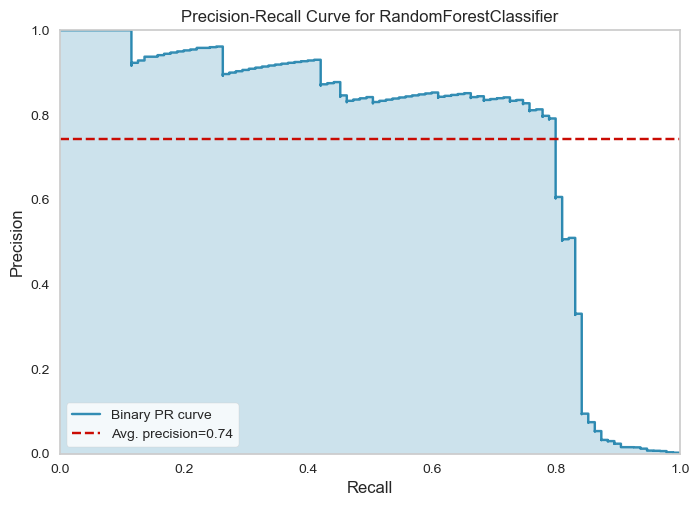

In [158]:
viz = PrecisionRecallCurve(smote_rf_model)

viz.fit(X_train, y_train)
viz.score(X_test, y_test)
viz.show();

In [159]:
y_pred_proba = smote_rf_model.predict_proba(X_test)
average_precision_score(y_test, y_pred_proba[:,1])

0.7427658431677323

In [160]:
y_pred = smote_rf_model.predict(X_test)
smote_rf_model_f1 = f1_score(y_test, y_pred)
smote_rf_model_recall = recall_score(y_test, y_pred)
smote_rf_model_ap = average_precision_score(y_test, y_pred)

#### Apply Model Evaluation Checks

In [161]:
train_ds = Dataset(X_train, label=y_train, cat_features=[])
test_ds = Dataset(X_test, label=y_test, cat_features=[])

In [162]:
result_smote = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=smote_rf_model)
result_smote

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 66 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_T0HD02FOWZMED8HNFHRYG04YN">Model Evaluation S…

### With SHAP

##### Feature Selection with Shap

In [163]:
import shap

In [164]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify =y)

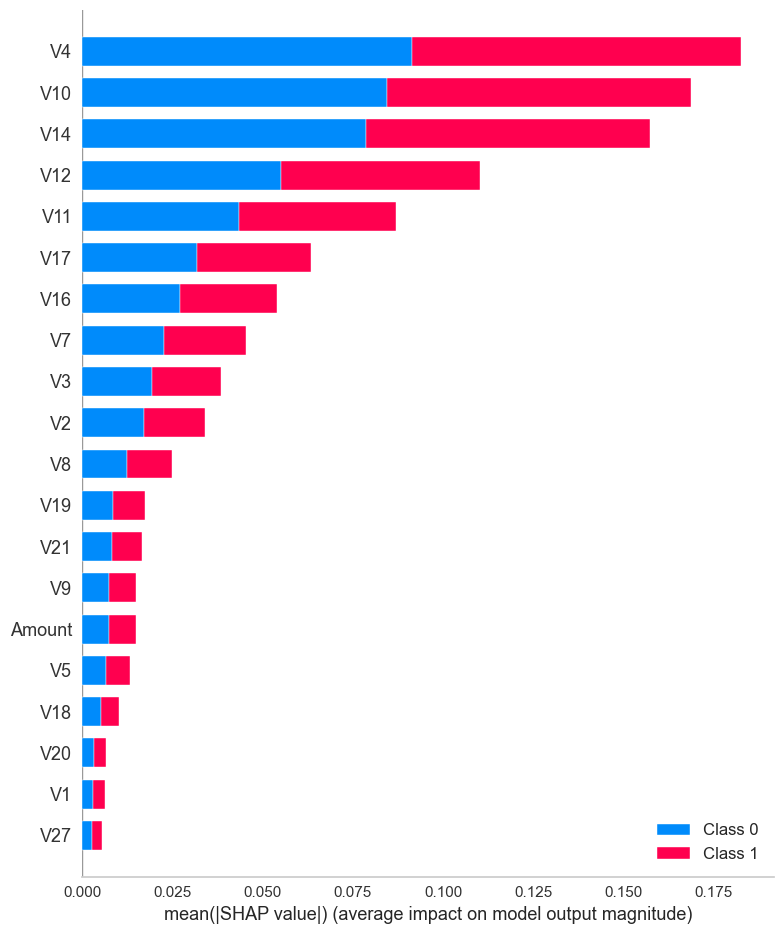

In [165]:
explainer = shap.TreeExplainer(smote_rf_model["rf"])
shap_values = explainer.shap_values(X_test,approximate=True)
shap.summary_plot(shap_values, X_test, plot_type="bar", feature_names=X.columns)

In [166]:
feature = ["V4",  'V14',  'V10', "V11", 'V12'] 

In [167]:
X2 = df[feature]
y = df.Class

In [168]:
X2.shape

(283723, 5)

#### ***i. Model Training***

In [169]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y, test_size=0.2, random_state=42, stratify =y)

In [170]:
shap_rf_model = RandomForestClassifier(max_depth=7, random_state=42)

In [171]:
shap_rf_model.fit(X_train2, y_train2)

RandomForestClassifier(max_depth=7, random_state=42)

In [172]:
eval_metric(shap_rf_model, X_train2, y_train2, X_test2, y_test2)

Test_Set
[[56643     7]
 [   27    68]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.91      0.72      0.80        95

    accuracy                           1.00     56745
   macro avg       0.95      0.86      0.90     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226587     13]
 [    68    310]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.96      0.82      0.88       378

    accuracy                           1.00    226978
   macro avg       0.98      0.91      0.94    226978
weighted avg       1.00      1.00      1.00    226978



***ii. Prediction and Model Evaluating and Tuning***

In [173]:
model = RandomForestClassifier(max_depth=7, random_state=42)

scores = cross_validate(model, X_train2, y_train2, scoring = ['accuracy', 'precision', 'recall', 'f1'], cv = 10)
df_scores = pd.DataFrame(scores, index = range(1, 11))
  
df_scores.mean()[2:]

test_accuracy     0.999467
test_precision    0.897261
test_recall       0.770199
test_f1           0.827422
dtype: float64

In [174]:
y_pred = shap_rf_model.predict(X_test2)
shap_rf_f1 = f1_score(y_test2, y_pred)
shap_rf_recall = recall_score(y_test2, y_pred)
shap_rf_auc = roc_auc_score(y_test2, y_pred)

##### with class_weight

In [175]:
class_weights = {0:1, 1:1}

In [176]:
shap_rf_model_weight = RandomForestClassifier(class_weight = class_weights, max_depth=7, random_state=42)

In [177]:
shap_rf_model_weight.fit(X_train2, y_train2)

RandomForestClassifier(class_weight={0: 1, 1: 1}, max_depth=7, random_state=42)

In [178]:
eval_metric(shap_rf_model_weight, X_train2, y_train2, X_test2, y_test2)

Test_Set
[[56643     7]
 [   27    68]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.91      0.72      0.80        95

    accuracy                           1.00     56745
   macro avg       0.95      0.86      0.90     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226587     13]
 [    68    310]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.96      0.82      0.88       378

    accuracy                           1.00    226978
   macro avg       0.98      0.91      0.94    226978
weighted avg       1.00      1.00      1.00    226978



In [179]:
model = RandomForestClassifier(class_weight = class_weights, max_depth=7, random_state=42)

scores = cross_validate(model, X_train2, y_train2, scoring = ['accuracy', 'precision', 'recall', 'f1'], cv = 10)
df_scores = pd.DataFrame(scores, index = range(1, 11))

df_scores.mean()[2:]

test_accuracy     0.999467
test_precision    0.897261
test_recall       0.770199
test_f1           0.827422
dtype: float64

In [180]:
y_pred = shap_rf_model_weight.predict(X_test2)
shap_rf_weight_f1 = f1_score(y_test2, y_pred)
shap_rf_weight_recall = recall_score(y_test2, y_pred)
shap_rf_weight_auc = roc_auc_score(y_test2, y_pred)

***v. Apply Model Evaluation Checks***
* link : https://docs.deepchecks.com/stable/user-guide/tabular/auto_quickstarts/plot_quick_model_evaluation.html

In [181]:
from deepchecks.tabular import Dataset

train_ds = Dataset(X_train2, label=y_train2, cat_features=[])
test_ds = Dataset(X_test2, label=y_test2, cat_features=[])

In [182]:
result_weight = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=shap_rf_model_weight)
result_weight

Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_Z6FMF38VUR1WO6F3QHOT6ZEGX">Model Evaluation S…

In [183]:
result_shap = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=shap_rf_model)
result_shap

Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_1BSJYZS45LBBY45AH4PGBVAJ7">Model Evaluation S…

### XGBoost Classifier with Unbalanced Data Techniques

### Import Libraries

***i. Model Training***

In [184]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify =y)

In [185]:
classes_weights = class_weight.compute_sample_weight(class_weight="balanced", y=y_train)
classes_weights

array([0.50083407, 0.50083407, 0.50083407, ..., 0.50083407, 0.50083407,
       0.50083407])

In [212]:
operations = [("xgb", XGBClassifier(random_state=42))]

pipeline_xgb_balanced = Pipeline(steps=operations)
pipeline_xgb_balanced.fit(X_train, y_train, xgb__sample_weight = classes_weights)

Pipeline(steps=[('xgb',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               predictor=None, random_state=42, ...))])

In [213]:
train_ds = Dataset(X_train, label=y_train, cat_features=[])
test_ds = Dataset(X_test, label=y_test, cat_features=[])

result = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=pipeline_xgb_balanced)
result

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 30 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_5B5DLYSRKBCORU6NUXWTFDO66">Model Evaluation S…

In [187]:
def eval_metric(model, X_train, y_train, X_test, y_test):
    
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)
    
    print("Test_Set")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))
    print()
    print("Train_Set")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred))

In [188]:
eval_metric(pipeline_xgb_balanced, X_train, y_train, X_test, y_test )

Test_Set
[[56644     6]
 [   22    73]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.92      0.77      0.84        95

    accuracy                           1.00     56745
   macro avg       0.96      0.88      0.92     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226600      0]
 [     0    378]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       1.00      1.00      1.00       378

    accuracy                           1.00    226978
   macro avg       1.00      1.00      1.00    226978
weighted avg       1.00      1.00      1.00    226978



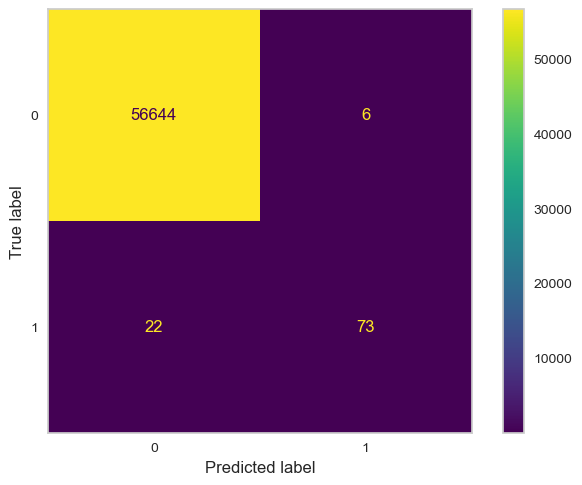

In [189]:
ConfusionMatrixDisplay.from_estimator(pipeline_xgb_balanced, X_test, y_test);

In [190]:
classes_weights = class_weight.compute_sample_weight(class_weight = {1:30, 0:1}, y = y_train)
classes_weights

array([1., 1., 1., ..., 1., 1., 1.])

In [210]:
operations = [("xgb", XGBClassifier(random_state=42))]

pipeline_xgb = Pipeline(steps=operations)
pipeline_xgb.fit(X_train, y_train, xgb__sample_weight=classes_weights)

Pipeline(steps=[('xgb',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               predictor=None, random_state=1, ...))])

In [211]:
train_ds = Dataset(X_train, label=y_train, cat_features=[])
test_ds = Dataset(X_test, label=y_test, cat_features=[])

result = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=pipeline_xgb)
result

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 37 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_WGTZYMO4HSL6OSWSZJUOAKWDW">Model Evaluation S…

In [199]:
eval_metric(pipeline_xgb, X_train, y_train, X_test, y_test )

Test_Set
[[56647     3]
 [   23    72]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.96      0.76      0.85        95

    accuracy                           1.00     56745
   macro avg       0.98      0.88      0.92     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226600      0]
 [     0    378]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       1.00      1.00      1.00       378

    accuracy                           1.00    226978
   macro avg       1.00      1.00      1.00    226978
weighted avg       1.00      1.00      1.00    226978



In [200]:
operations = [("xgb", XGBClassifier(scale_pos_weight=35, random_state=42))]

pipeline_xgb = Pipeline(steps=operations)
pipeline_xgb.fit(X_train, y_train)

Pipeline(steps=[('xgb',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               predictor=None, random_state=1, ...))])

In [201]:
eval_metric(pipeline_xgb, X_train, y_train, X_test, y_test )

Test_Set
[[56647     3]
 [   23    72]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.96      0.76      0.85        95

    accuracy                           1.00     56745
   macro avg       0.98      0.88      0.92     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226600      0]
 [     0    378]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       1.00      1.00      1.00       378

    accuracy                           1.00    226978
   macro avg       1.00      1.00      1.00    226978
weighted avg       1.00      1.00      1.00    226978



### Cross Valide

In [202]:
operations = [ ("xgb", XGBClassifier(random_state=42, scale_pos_weight=35))]

model = Pipeline(operations)
scores = cross_validate(model, X_train, y_train, scoring = ['precision','recall','f1'], cv = 10,return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_precision     0.923727
train_precision    1.000000
test_recall        0.817710
train_recall       1.000000
test_f1            0.866439
train_f1           1.000000
dtype: float64

In [215]:
train_ds = Dataset(X_train, label=y_train, cat_features=[])
test_ds = Dataset(X_test, label=y_test, cat_features=[])

result = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=pipeline_xgb)
result

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 30 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_O9KFAU3LJVIYP08PA3IH1CFBS">Model Evaluation S…

### GridSearch

In [206]:
operations = [ ("xgb", XGBClassifier(random_state=42, scale_pos_weight=35))]

model = Pipeline(steps=operations)

# define grid parameters
param_grid = {"xgb__n_estimators":[50],        # [50, 100,200]
              'xgb__max_depth':[1,2,8],
              "xgb__learning_rate": [0.70],     #  [0.01,002,0.2,0.7]
              "xgb__subsample":[0.8],
              "xgb__colsample_bytree":[0.6]           # [0.6,0.8,1]
             }


xgb_grid_model = GridSearchCV(estimator=model,
                              param_grid=param_grid,
                              scoring = 'recall',
                              n_jobs = -1,
                              cv=10,
                              verbose=1)



In [208]:
xgb_grid_model.fit(X_train, y_train)

Fitting 10 folds for each of 3 candidates, totalling 30 fits


GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('xgb',
                                        XGBClassifier(base_score=None,
                                                      booster=None,
                                                      callbacks=None,
                                                      colsample_bylevel=None,
                                                      colsample_bynode=None,
                                                      colsample_bytree=None,
                                                      early_stopping_rounds=None,
                                                      enable_categorical=False,
                                                      eval_metric=None,
                                                      feature_types=None,
                                                      gamma=None, gpu_id=None,
                                                      grow_policy=None,
                                                      importance_type=None,
                                                      interaction_constraints=...
                                                      max_depth=None,
                                                      max_leaves=None,
                                                      min_child_weight=None,
                                                      missing=nan,
                                                      monotone_constraints=None,
                                                      n_estimators=100,
                                                      n_jobs=None,
                                                      num_parallel_tree=None,
                                                      predictor=None,
                                                      random_state=1, ...))]),
             n_jobs=-1,
             param_grid={'xgb__colsample_bytree': [0.6],
                         'xgb__learning_rate': [0.7],
                         'xgb__max_depth': [1, 2, 8], 'xgb__n_estimators': [50],
                         'xgb__subsample': [0.8]},
             scoring='recall', verbose=1)

In [214]:
train_ds = Dataset(X_train, label=y_train, cat_features=[])
test_ds = Dataset(X_test, label=y_test, cat_features=[])

result = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=xgb_grid_model)
result

deepchecks - WARNING - Could not find built-in feature importance on the model, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 22 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_LR34SGN84QROROX4Q2NO4N5KU">Model Evaluation S…

In [216]:
eval_metric(xgb_grid_model, X_train,y_train, X_test,y_test)

Test_Set
[[56564    86]
 [   19    76]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.47      0.80      0.59        95

    accuracy                           1.00     56745
   macro avg       0.73      0.90      0.80     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226289    311]
 [    41    337]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.52      0.89      0.66       378

    accuracy                           1.00    226978
   macro avg       0.76      0.95      0.83    226978
weighted avg       1.00      1.00      1.00    226978



In [217]:
xgb_grid_model.best_estimator_

Pipeline(steps=[('xgb',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=0.6, early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=0.7,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=1, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=50,
                               n_jobs=None, num_parallel_tree=None,
                               predictor=None, random_state=1, ...))])

In [218]:
xgb_grid_model.best_params_

{'xgb__colsample_bytree': 0.6,
 'xgb__learning_rate': 0.7,
 'xgb__max_depth': 1,
 'xgb__n_estimators': 50,
 'xgb__subsample': 0.8}

In [219]:
xgb_grid_model.best_score_

0.8598862019914651

In [225]:
y_pred = xgb_grid_model.predict(X_test)
xgb_grid_model_f1 = f1_score(y_test, y_pred)
xgb_grid_model_recall = recall_score(y_test, y_pred)
xgb_grid_model_ap = average_precision_score(y_test, y_pred)

### Feature Selection for XGBoost

In [232]:
xgb_importance = ["V14","V17","V4","V12","V16"]

In [233]:
X3 = df[xgb_importance]
y = df['Class']

In [234]:
X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y, test_size=0.2, stratify=y, random_state=42)

In [235]:
operations = [("xgb_importance", XGBClassifier(n_estimators= 50,
                                 colsample_bytree = 0.6,
                                 subsample= 0.8,
                                 learning_rate = 0.7,
                                 max_depth= 8,
                                 random_state=42,
                                 scale_pos_weight=35))]

xgb_feature_model = Pipeline(steps=operations)
xgb_feature_model.fit(X3_train, y3_train)

Pipeline(steps=[('xgb_importance',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=0.6, early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=0.7,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=8, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=50,
                               n_jobs=None, num_parallel_tree=None,
                               predictor=None, random_state=1, ...))])

In [237]:
train_ds = Dataset(X3_train, label=y3_train, cat_features=[])
test_ds = Dataset(X3_test, label=y3_test, cat_features=[])

result = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=xgb_feature_model)
result

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 3 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_72P9RH5RP3ADHXBZ3RQPBA9S7">Model Evaluation S…

In [238]:
y_pred = xgb_feature_model.predict(X3_test)
xgb_feature_model_f1 = f1_score(y3_test, y_pred)
xgb_feature_model_recall = recall_score(y3_test, y_pred)
xgb_feature_model_ap = average_precision_score(y3_test, y_pred)

### Cross Validation

In [239]:
operations = [("xgb_importance", XGBClassifier(n_estimators= 50,
                                 colsample_bytree = 0.6,
                                 subsample= 0.8,
                                 learning_rate = 0.7,
                                 max_depth= 8,
                                 random_state=42,
                                 scale_pos_weight=35))]

model = Pipeline(operations)
scores = cross_validate(model, X3_train, y3_train, scoring = ['precision','recall','f1'], cv = 10,return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_precision     0.862039
train_precision    0.991914
test_recall        0.809602
train_recall       1.000000
test_f1            0.834172
train_f1           0.995787
dtype: float64

## XGBoost Classifier with SMOTE

In [240]:
over = SMOTE(sampling_strategy={1: 1000}, k_neighbors=3, random_state=42)
under = RandomUnderSampler(sampling_strategy={0: 200000}, random_state=42)

operations = [('o', over), ('u', under), ('smote_XGB', XGBClassifier(random_state=42))]

smote_pipeline_xgb = imbpipeline(steps=operations)
smote_pipeline_xgb.fit(X_train, y_train)

Pipeline(steps=[('o',
                 SMOTE(k_neighbors=3, random_state=1,
                       sampling_strategy={1: 1000})),
                ('u',
                 RandomUnderSampler(random_state=1,
                                    sampling_strategy={0: 200000})),
                ('smote_XGB',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_...
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               predictor=None, random_state=1, ...))])

In [241]:
train_ds = Dataset(X_train, label=y_train, cat_features=[])
test_ds = Dataset(X_test, label=y_test, cat_features=[])

result = model_evaluation().run(train_dataset=train_ds, test_dataset=test_ds, model=smote_pipeline_xgb)
result

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 28 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_YMLWSIJJ88HCYTPT6KIAWPCZ8">Model Evaluation S…

In [242]:
eval_metric(smote_pipeline_xgb, X_train,y_train, X_test,y_test)

Test_Set
[[56643     7]
 [   23    72]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.91      0.76      0.83        95

    accuracy                           1.00     56745
   macro avg       0.96      0.88      0.91     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226590     10]
 [     0    378]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.97      1.00      0.99       378

    accuracy                           1.00    226978
   macro avg       0.99      1.00      0.99    226978
weighted avg       1.00      1.00      1.00    226978



In [243]:
model = smote_pipeline_xgb
scores = cross_validate(model, X_train, y_train, scoring = ['precision','recall','f1'], cv = 10, return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_precision     0.909893
train_precision    0.995322
test_recall        0.822973
train_recall       1.000000
test_f1            0.863634
train_f1           0.997655
dtype: float64

In [244]:
eval_metric(smote_pipeline_xgb, X_train,y_train, X_test,y_test)

Test_Set
[[56643     7]
 [   23    72]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.91      0.76      0.83        95

    accuracy                           1.00     56745
   macro avg       0.96      0.88      0.91     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226590     10]
 [     0    378]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.97      1.00      0.99       378

    accuracy                           1.00    226978
   macro avg       0.99      1.00      0.99    226978
weighted avg       1.00      1.00      1.00    226978



## GridSearchCV with Smote Model

In [245]:
operations = [('o', over), ('u', under), ('sm_XGB_best', XGBClassifier(random_state=42))]

sm_pipeline_xgb_best = imbpipeline(steps=operations)
sm_pipeline_xgb_best.fit(X_train, y_train)

# define grid parameters
param_grid = {"sm_XGB_best__n_estimators":[50],        # [50, 100,200]
              'sm_XGB_best__max_depth':[1,2,8],
              "sm_XGB_best__learning_rate": [0.70],     #  [0.01,002,0.2,0.7]
              "sm_XGB_best__subsample":[0.8],
              "sm_XGB_best__colsample_bytree":[0.6]           # [0.6,0.8,1]
             }


sm_pipeline_xgb_best = GridSearchCV(  sm_pipeline_xgb_best ,
                                      param_grid=param_grid,
                                      scoring = 'recall',
                                      n_jobs = -1,
                                      cv=10,
                                      verbose=1)

sm_pipeline_xgb_best.fit(X_train, y_train)

Fitting 10 folds for each of 3 candidates, totalling 30 fits


GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('o',
                                        SMOTE(k_neighbors=3, random_state=1,
                                              sampling_strategy={1: 1000})),
                                       ('u',
                                        RandomUnderSampler(random_state=1,
                                                           sampling_strategy={0: 200000})),
                                       ('sm_XGB_best',
                                        XGBClassifier(base_score=None,
                                                      booster=None,
                                                      callbacks=None,
                                                      colsample_bylevel=None,
                                                      colsample_bynode=None,
                                                      colsample_bytree=None,
                                                      early_stopping_rounds=None...
                                                      min_child_weight=None,
                                                      missing=nan,
                                                      monotone_constraints=None,
                                                      n_estimators=100,
                                                      n_jobs=None,
                                                      num_parallel_tree=None,
                                                      predictor=None,
                                                      random_state=1, ...))]),
             n_jobs=-1,
             param_grid={'sm_XGB_best__colsample_bytree': [0.6],
                         'sm_XGB_best__learning_rate': [0.7],
                         'sm_XGB_best__max_depth': [1, 2, 8],
                         'sm_XGB_best__n_estimators': [50],
                         'sm_XGB_best__subsample': [0.8]},
             scoring='recall', verbose=1)

In [246]:
sm_pipeline_xgb_best.best_params_

{'sm_XGB_best__colsample_bytree': 0.6,
 'sm_XGB_best__learning_rate': 0.7,
 'sm_XGB_best__max_depth': 8,
 'sm_XGB_best__n_estimators': 50,
 'sm_XGB_best__subsample': 0.8}

In [247]:
eval_metric(sm_pipeline_xgb_best, X_train,y_train, X_test,y_test)

Test_Set
[[56641     9]
 [   23    72]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.89      0.76      0.82        95

    accuracy                           1.00     56745
   macro avg       0.94      0.88      0.91     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226592      8]
 [     0    378]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.98      1.00      0.99       378

    accuracy                           1.00    226978
   macro avg       0.99      1.00      0.99    226978
weighted avg       1.00      1.00      1.00    226978



In [248]:
operations = [('o', over), ('u', under), ("xgb_best", XGBClassifier(n_estimators= 50, #best parameters
                                                                    colsample_bytree = 0.6,
                                                                    subsample= 0.8,
                                                                    learning_rate = 0.7,
                                                                    max_depth= 8,
                                                                    random_state=42,
                                                                    scale_pos_weight=35))]

sm_pipeline_xgb_best = imbpipeline(steps=operations)
sm_pipeline_xgb_best.fit(X_train, y_train)

Pipeline(steps=[('o',
                 SMOTE(k_neighbors=3, random_state=1,
                       sampling_strategy={1: 1000})),
                ('u',
                 RandomUnderSampler(random_state=1,
                                    sampling_strategy={0: 200000})),
                ('xgb_best',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=0.6, early_stopping_rounds=None,
                               enable_categorical=False, eval_me...
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=0.7,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=8, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=50,
                               n_jobs=None, num_parallel_tree=None,
                               predictor=None, random_state=1, ...))])

In [249]:
eval_metric(sm_pipeline_xgb_best, X_train,y_train, X_test,y_test)

Test_Set
[[56637    13]
 [   24    71]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.85      0.75      0.79        95

    accuracy                           1.00     56745
   macro avg       0.92      0.87      0.90     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226591      9]
 [     0    378]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.98      1.00      0.99       378

    accuracy                           1.00    226978
   macro avg       0.99      1.00      0.99    226978
weighted avg       1.00      1.00      1.00    226978



In [250]:
model = sm_pipeline_xgb_best
scores = cross_validate(model, X_train, y_train, scoring = ['precision','recall','f1'], cv = 10, return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_precision     0.897375
train_precision    0.994741
test_recall        0.833570
train_recall       1.000000
test_f1            0.862756
train_f1           0.997363
dtype: float64

***ii. Prediction and Model Evaluating and Tuning***

In [251]:
y_pred = sm_pipeline_xgb_best.predict(X_test)

XGBoost_smote_precision = precision_score(y_test, y_pred, labels=["Class"])
XGBoost_smote_recall = recall_score(y_test, y_pred, labels=["Class"])
XGBoost_smote_f1 = f1_score(y_test, y_pred, labels=["Class"])

***iii. Plot Precision and Recall Curve***


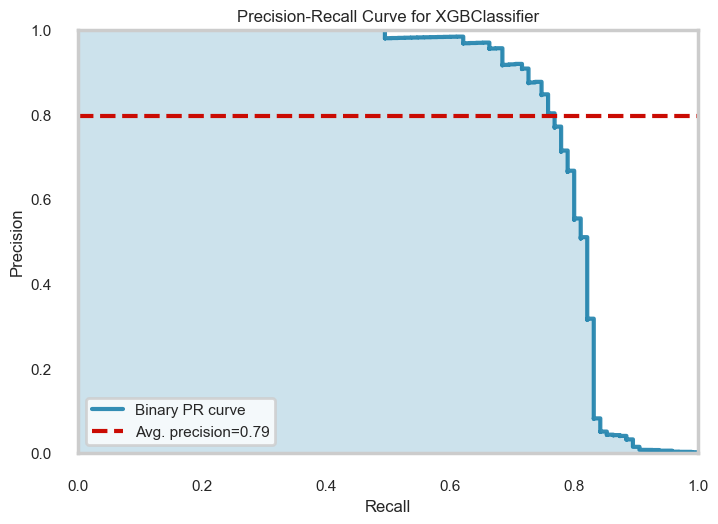

In [252]:
viz = PrecisionRecallCurve(sm_pipeline_xgb_best)

viz.fit(X_train, y_train)
viz.score(X_test, y_test)
viz.show();

In [253]:
y_pred = sm_pipeline_xgb_best.predict(X_test)
sm_pipeline_xgb_best_f1 = f1_score(y_test, y_pred)
sm_pipeline_xgb_best_recall = recall_score(y_test, y_pred)
sm_pipeline_xgb_best_ap = average_precision_score(y_test, y_pred)

***v. Apply Model Evaluation Checks***
* link : https://docs.deepchecks.com/stable/user-guide/tabular/auto_quickstarts/plot_quick_model_evaluation.html

In [254]:
train_ds = Dataset(X_train, label=y_train, cat_features=[])
test_ds = Dataset(X_test, label=y_test, cat_features=[])

In [255]:
res = model_evaluation().run(train_ds, test_ds, sm_pipeline_xgb_best)
res

deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead
deepchecks - INFO - Calculating permutation feature importance. Expected to finish in 28 seconds


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_XLGX8PSPG3SYOAF5AI9OCCQAK">Model Evaluation S…

### Neural Network

In the final step, you will make classification with Neural Network which is a Deep Learning algorithm. 

Neural networks are a series of algorithms that mimic the operations of a human brain to recognize relationships between vast amounts of data. They are used in a variety of applications in financial services, from forecasting and marketing research to fraud detection and risk assessment.

A neural network contains layers of interconnected nodes. Each node is a perceptron and is similar to a multiple linear regression. The perceptron feeds the signal produced by a multiple linear regression into an activation function that may be nonlinear.

In a multi-layered perceptron (MLP), perceptrons are arranged in interconnected layers. The input layer collects input patterns. The output layer has classifications or output signals to which input patterns may map. 

Hidden layers fine-tune the input weightings until the neural network’s margin of error is minimal. It is hypothesized that hidden layers extrapolate salient features in the input data that have predictive power regarding the outputs.

You will discover **[how to create](https://towardsdatascience.com/building-our-first-neural-network-in-keras-bdc8abbc17f5)** your deep learning neural network model in Python using **[Keras](https://keras.io/about/)**. Keras is a powerful and easy-to-use free open source Python library for developing and evaluating deep learning models.

- The steps you are going to cover for this algorithm are as follows:

   *i. Import Libraries*
   
   *ii. Define Model*
    
   *iii. Compile Model*
   
   *iv. Fit Model*
   
   *v. Prediction and Model Evaluating*
   
   *vi. Plot Precision and Recall Curve*

***ii. Define Model***

In [256]:
X2 = df.drop(columns="Class")
y = df["Class"]
seed = 42

In [257]:
X_train, X_test, y_train, y_test = train_test_split(X2, y, test_size=0.2, random_state=42, stratify =y)

In [258]:
scaler = StandardScaler()

In [259]:
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [260]:
tf.random.set_seed(seed)

model_ann = Sequential()

model_ann.add(Dense(30, activation = "relu", input_dim = X_train.shape[1]))
model_ann.add(Dense(15, activation = "relu"))
model_ann.add(Dense(1, activation = "sigmoid"))

***iii. Compile Model***

In [261]:
model_ann.compile(optimizer = "adam", loss = "binary_crossentropy", metrics = ["Recall"])

***iv. Fit Model***

In [262]:
early_stop = EarlyStopping(monitor="val_loss",
                           mode="auto",
                           verbose=1,
                           patience=5, restore_best_weights = True)

In [336]:
model_ann.fit(x = X_train, y = y_train, validation_split = 0.1, batch_size = 32, epochs = 200, callbacks=[early_stop], verbose=1)

Epoch 1/200
6384/6384 [==============================] - 15s 2ms/step - loss: 9.1180 - recall: 0.0232 - val_loss: 4.4488 - val_recall: 0.0000e+00
Epoch 2/200
6384/6384 [==============================] - 15s 2ms/step - loss: 2.5946 - recall: 0.1072 - val_loss: 3.8606 - val_recall: 0.0000e+00
Epoch 3/200
6384/6384 [==============================] - 11s 2ms/step - loss: 0.9636 - recall: 0.1449 - val_loss: 0.7286 - val_recall: 0.0732
Epoch 4/200
6384/6384 [==============================] - 11s 2ms/step - loss: 0.3348 - recall: 0.1188 - val_loss: 0.4512 - val_recall: 0.0000e+00
Epoch 5/200
6384/6384 [==============================] - 9s 1ms/step - loss: 0.2392 - recall: 0.0174 - val_loss: 0.1390 - val_recall: 0.0000e+00
Epoch 6/200
6384/6384 [==============================] - 11s 2ms/step - loss: 0.0492 - recall: 0.0551 - val_loss: 0.0356 - val_recall: 0.1707
Epoch 7/200
6384/6384 [==============================] - 11s 2ms/step - loss: 0.0156 - recall: 0.0000e+00 - val_loss: 0.0180 - val_re

In [337]:
model_ann.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_15 (Dense)            (None, 30)                930       
                                                                 
 dense_16 (Dense)            (None, 15)                465       
                                                                 
 dense_17 (Dense)            (None, 1)                 16        
                                                                 
Total params: 1,411
Trainable params: 1,411
Non-trainable params: 0
_________________________________________________________________


In [338]:
loss_df = pd.DataFrame(model_ann.history.history)
loss_df.head()

,loss,recall,val_loss,val_recall
0,9.117988,0.023188,4.448780,0.000000
1,2.594638,0.107246,3.860594,0.000000
2,0.963627,0.144928,0.728600,0.073171
3,0.334796,0.118841,0.451197,0.000000
4,0.239231,0.017391,0.138984,0.000000


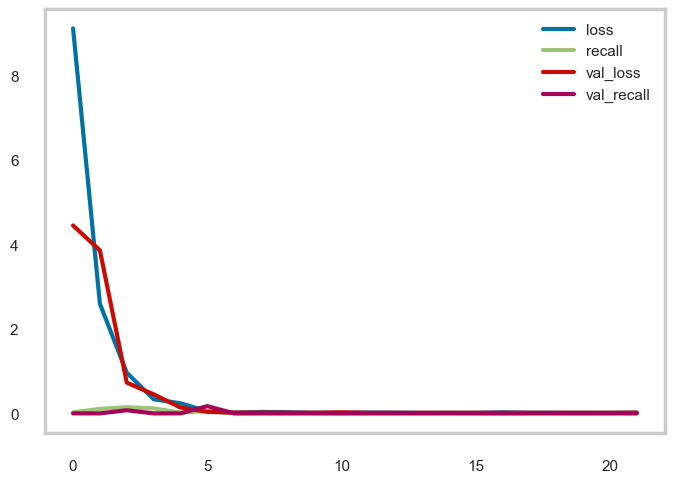

In [339]:
loss_df.plot();

***v. Prediction and Model Evaluating***

In [340]:
model_ann.evaluate(X_test, y_test, verbose=0) 

[0.011708797886967659, 0.0]

In [341]:
loss, recall = model_ann.evaluate(X_test, y_test, verbose=0)
print("loss : ", loss)
print("Recall : ", recall)

loss :  0.011708797886967659
Recall :  0.0


In [342]:
y_pred = (model_ann.predict(X_test) > 0.5).astype("int32")
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

1774/1774 [==============================] - 1s 722us/step
[[56658     0]
 [   87     0]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56658
           1       0.00      0.00      0.00        87

    accuracy                           1.00     56745
   macro avg       0.50      0.50      0.50     56745
weighted avg       1.00      1.00      1.00     56745



1774/1774 [==============================] - 1s 734us/step


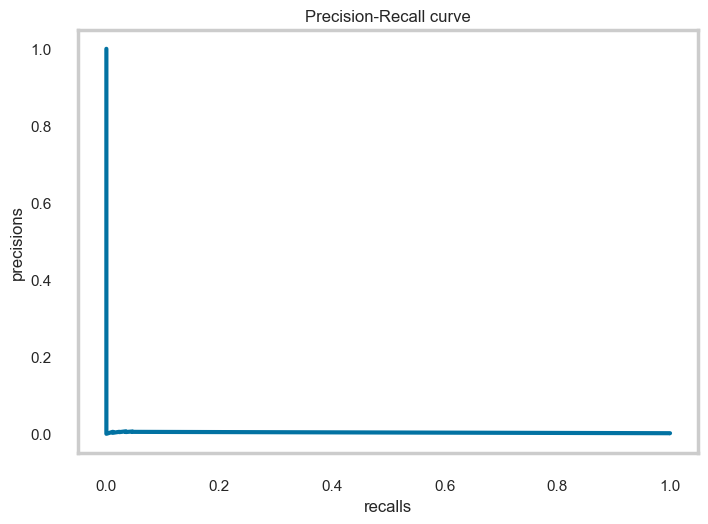

In [343]:
y_pred_proba = model_ann.predict(X_test)
precisions, recalls, thresholds = precision_recall_curve(y_test, y_pred_proba)
plt.plot(recalls, precisions, label='ANN')
plt.xlabel('recalls')
plt.ylabel('precisions')
plt.title('Precision-Recall curve')
plt.show()

In [344]:
average_precision_score(y_test, y_pred_proba)

0.001729299412660353

In [345]:
model_ann_f1 = f1_score(y_test, y_pred)
model_ann_recall = recall_score(y_test, y_pred)
model_ann_ap = average_precision_score(y_test, y_pred)

#### with class_weight

In [346]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(30, activation = "relu", input_dim = X_train.shape[1]))
model.add(Dense(15, activation = "relu"))
model.add(Dense(8, activation = "relu"))
model.add(Dense(1, activation = "sigmoid"))

In [347]:
model.compile(optimizer = "adam", loss = "binary_crossentropy", metrics = ["Recall"])

In [348]:
class_weights = {0 : 1, 1 : 30}

In [349]:
model.fit(x = X_train, y = y_train, validation_split = 0.1, batch_size = 32, epochs = 200, callbacks=[early_stop], class_weight=class_weights, verbose=1)

Epoch 1/200
6384/6384 [==============================] - 13s 2ms/step - loss: 10.4652 - recall: 0.1072 - val_loss: 0.0353 - val_recall: 0.0000e+00
Epoch 2/200
6384/6384 [==============================] - 12s 2ms/step - loss: 0.2845 - recall: 0.0493 - val_loss: 0.0756 - val_recall: 0.0000e+00
Epoch 3/200
6384/6384 [==============================] - 12s 2ms/step - loss: 0.2042 - recall: 0.0000e+00 - val_loss: 0.0583 - val_recall: 0.0000e+00
Epoch 4/200
6384/6384 [==============================] - 11s 2ms/step - loss: 0.2197 - recall: 0.0000e+00 - val_loss: 0.0548 - val_recall: 0.0000e+00
Epoch 5/200
6384/6384 [==============================] - 12s 2ms/step - loss: 0.2031 - recall: 0.0000e+00 - val_loss: 0.0548 - val_recall: 0.0000e+00
Epoch 6/200
6384/6384 [==============================] - 14s 2ms/step - loss: 0.2338 - recall: 0.0000e+00 - val_loss: 0.0559 - val_recall: 0.0000e+00
Epoch 6: early stopping


In [350]:
model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_22 (Dense)            (None, 30)                930       
                                                                 
 dense_23 (Dense)            (None, 15)                465       
                                                                 
 dense_24 (Dense)            (None, 8)                 128       
                                                                 
 dense_25 (Dense)            (None, 1)                 9         
                                                                 
Total params: 1,532
Trainable params: 1,532
Non-trainable params: 0
_________________________________________________________________


In [351]:
loss_df = pd.DataFrame(model.history.history)
loss_df.head()

,loss,recall,val_loss,val_recall
0,10.465221,0.107246,0.035251,0.0
1,0.284543,0.049275,0.075576,0.0
2,0.204186,0.000000,0.058348,0.0
3,0.219711,0.000000,0.054848,0.0
4,0.203056,0.000000,0.054818,0.0


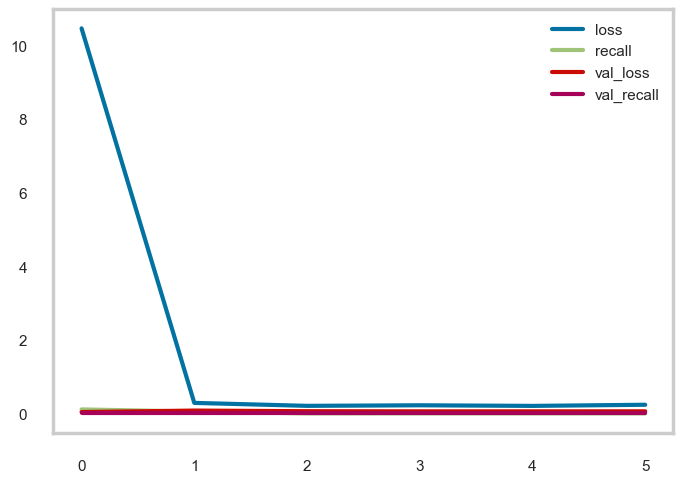

In [352]:
loss_df.plot();

#### v. Prediction and Model Evaluating

In [353]:
model.evaluate(X_test, y_test, verbose=0)  

[0.033713631331920624, 0.0]

In [354]:
loss, recall = model.evaluate(X_test, y_test, verbose=0)
print("loss : ", loss)
print("Recall : ", recall)

loss :  0.033713631331920624
Recall :  0.0


In [355]:
#with class_weight = 10
y_pred = (model.predict(X_test) > 0.5).astype("int32")
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

1774/1774 [==============================] - 2s 843us/step
[[56656     2]
 [   87     0]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56658
           1       0.00      0.00      0.00        87

    accuracy                           1.00     56745
   macro avg       0.50      0.50      0.50     56745
weighted avg       1.00      1.00      1.00     56745



***vi. Plot Precision and Recall Curve***

1774/1774 [==============================] - 1s 774us/step


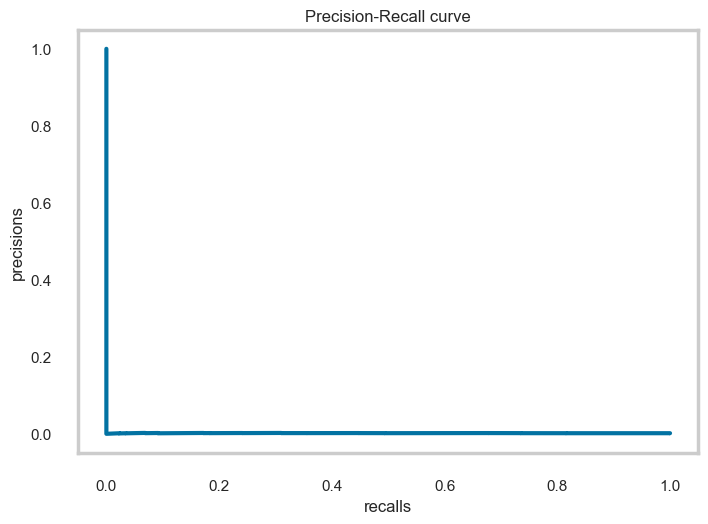

In [356]:
y_pred_proba = model.predict(X_test)
precisions, recalls, thresholds = precision_recall_curve(y_test, y_pred_proba)
plt.plot(recalls, precisions, label='ANN')
plt.xlabel('recalls')
plt.ylabel('precisions')
plt.title('Precision-Recall curve')
plt.show()

In [357]:
average_precision_score(y_test, y_pred_proba)

0.0017870659203822227

***v. Apply Model Evaluation Checks***
* link : https://docs.deepchecks.com/stable/user-guide/tabular/auto_quickstarts/plot_quick_model_evaluation.html

In [358]:
X_train, X_test, y_train, y_test = train_test_split(X2, y, test_size=0.2, random_state=42)

In [359]:
train_ann = Dataset(X_train, label=y_train, cat_features=[])
test_ann = Dataset(X_test, label=y_test, cat_features=[])

In [360]:
ann = model_evaluation().run(train_ann, test_ann, model_ann)
ann

1774/1774 [==============================] - 2s 859us/step


1/1 [==============================] - 0s 9ms/step


deepchecks - WARNING - Could not find built-in feature importance on the model, using permutation feature importance calculation instead


313/313 [==============================] - 0s 856us/step


deepchecks - WARNING - Features importance was not calculated:
Skipping permutation importance calculation: calculation was projected to finish in 403 seconds, but timeout was configured to 120 seconds


32/32 [==============================] - 0s 1ms/step


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_6NXY3H2FOXKD1822SGQNFTX7Q">Model Evaluation S…

#### Neural Network With SMOTE

In [361]:
smote = SMOTE(
                sampling_strategy = 0.2, random_state= 42) 
under = RandomUnderSampler(
                            sampling_strategy = 0.9, 
                            random_state= 42
                          ) 
column_trans = make_column_transformer(
                                        (RobustScaler(), ['Amount']),
                                        remainder = StandardScaler()
                                      )

In [362]:
tf.random.set_seed(42) # for reproducibility

models = Sequential() # instantiate the model

models.add(Dense(64, activation="relu")) # add the input layer and the first hidden layer
models.add(Dense(32, activation="relu"))  # add the second hidden layer
models.add(Dense(16, activation="relu"))
models.add(BatchNormalization())
models.add(Dense(1, activation="sigmoid")) # add the output layer

opt = Adam(learning_rate=0.00005) # optimizer 
models.compile(optimizer=opt, 
              loss="binary_crossentropy",
              metrics=["Recall"])

In [363]:
def eval_metric_classification(model, X_train, y_train, X_test, y_test, model_name='', average=None, labels=None, ml_model=True):
    """ average (None, 'micro', 'macro', 'samples', 'weighted', 'binary')"""
    # The style parameters control properties like the color of the background and whether a grid is enabled by default.
    sns.set_style("whitegrid", {'axes.grid' : False})
    sns.set_context("poster", font_scale = .5, rc={"grid.linewidth": 10})
    if ml_model:
        y_pred_test = model.predict(X_test)
        y_pred_train = model.predict(X_train)
        #y_prob=model.predict_proba(X_test)
    else:
        y_pred_test = model.predict(X_test) >= 0.5
        y_pred_train = model.predict(X_train) >= 0.5

In [364]:
ann_smote = Pipeline_imb([
    ("column_trans", column_trans),
    ("smote", smote),
    ("under", under),
    ("ann", models),
])

In [365]:
ann_smote.fit(X_train, y_train, ann__batch_size = 16, ann__epochs =10,ann__callbacks = [early_stop])

Epoch 1/10
5980/5980 [==============================] - 10s 2ms/step - loss: 0.2267 - recall: 0.8802
Epoch 2/10
5980/5980 [==============================] - 10s 2ms/step - loss: 0.0932 - recall: 0.9614
Epoch 3/10
5980/5980 [==============================] - 11s 2ms/step - loss: 0.0614 - recall: 0.9787
Epoch 4/10
5980/5980 [==============================] - 11s 2ms/step - loss: 0.0437 - recall: 0.9873
Epoch 5/10
5980/5980 [==============================] - 10s 2ms/step - loss: 0.0334 - recall: 0.9913
Epoch 6/10
5980/5980 [==============================] - 12s 2ms/step - loss: 0.0269 - recall: 0.9940
Epoch 7/10
5980/5980 [==============================] - 12s 2ms/step - loss: 0.0235 - recall: 0.9949
Epoch 8/10
5980/5980 [==============================] - 11s 2ms/step - loss: 0.0195 - recall: 0.9957
Epoch 9/10
5980/5980 [==============================] - 10s 2ms/step - loss: 0.0168 - recall: 0.9964
Epoch 10/10
5980/5980 [==============================] - 11s 2ms/step - loss: 0.0149 - reca

Pipeline(steps=[('column_trans',
                 ColumnTransformer(remainder=StandardScaler(),
                                   transformers=[('robustscaler',
                                                  RobustScaler(),
                                                  ['Amount'])])),
                ('smote', SMOTE(random_state=42, sampling_strategy=0.2)),
                ('under',
                 RandomUnderSampler(random_state=42, sampling_strategy=0.9)),
                ('ann',
                 <keras.engine.sequential.Sequential object at 0x000002012099DCF0>)])

In [366]:
out_score_ann_smote = eval_metric_classification(
                                            ann_smote, X_train, y_train, X_test, y_test, 
                                            'ANN_smote Classification', ml_model=False, average=None, labels=[1]
                                        )
out_score_ann_smote

7094/7094 [==============================] - 8s 1ms/step


#### Apply Model Evaluation Checks

In [367]:
X_train, X_test, y_train, y_test = train_test_split(X2, y, test_size=0.2, random_state=42)

In [368]:
train_ann_smote = Dataset(X_train, label=y_train, cat_features=[])
test_ann_smote = Dataset(X_test, label=y_test, cat_features=[])

In [369]:
ann_smote = model_evaluation().run(train_ann_smote, test_ann_smote, ann_smote)
ann

1774/1774 [==============================] - 2s 1ms/step


1/1 [==============================] - 0s 16ms/step


deepchecks - WARNING - Cannot use model's built-in feature importance on a Scikit-learn Pipeline, using permutation feature importance calculation instead


313/313 [==============================] - 0s 927us/step


deepchecks - WARNING - Features importance was not calculated:
Skipping permutation importance calculation: calculation was projected to finish in 415 seconds, but timeout was configured to 120 seconds


32/32 [==============================] - 0s 1ms/step


Accordion(children=(VBox(children=(HTML(value='\n<h1 id="summary_A7G4Q7KL4UJR9D5M79VVSWFRQ">Model Evaluation S…

In [370]:
ann_smote_f1 = f1_score(y_test, y_pred)
ann_smote_recall = recall_score(y_test,y_pred)
ann_smote_ap = roc_auc_score(y_test, y_pred)

#### MODEL COMPARASION

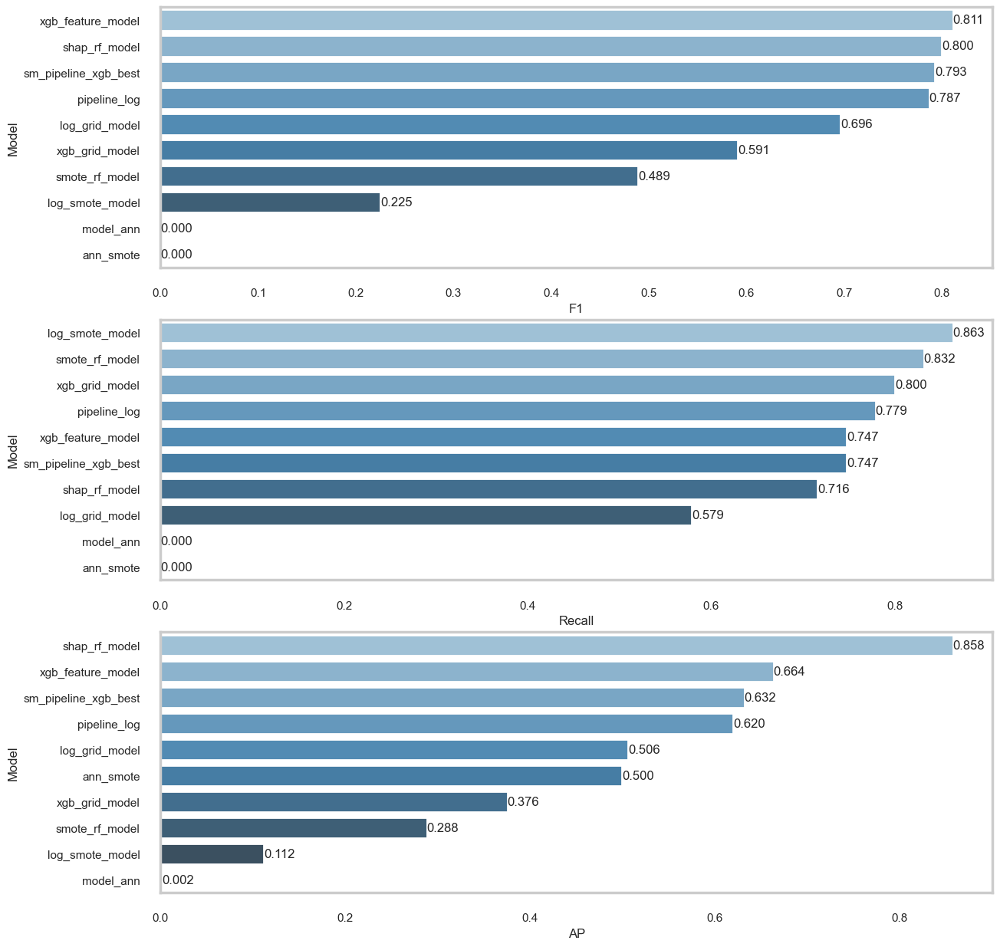

In [371]:
compare = pd.DataFrame({
    "Model": [ "pipeline_log", "log_grid_model", "log_smote_model", 
              "smote_rf_model", "shap_rf_model",
              "xgb_grid_model", "xgb_feature_model", 
              "sm_pipeline_xgb_best", "model_ann", "ann_smote"],
    "F1": [pipeline_log_f1, log_grid_model_f1, log_smote_model_f1, smote_rf_model_f1, shap_rf_f1, xgb_grid_model_f1, xgb_feature_model_f1, sm_pipeline_xgb_best_f1, model_ann_f1, ann_smote_f1],
    "Recall": [pipeline_log_recall, log_grid_model_recall, log_smote_model_recall, smote_rf_model_recall, shap_rf_recall, xgb_grid_model_recall, xgb_feature_model_recall, sm_pipeline_xgb_best_recall, model_ann_recall, ann_smote_recall],
    "AP": [pipeline_log_ap,log_grid_model_ap, log_smote_model_ap, smote_rf_model_ap, shap_rf_auc, xgb_grid_model_ap, xgb_feature_model_ap, sm_pipeline_xgb_best_ap, model_ann_ap, ann_smote_ap]
})




def labels(ax):
    for p in ax.patches:
        width = p.get_width()  # get bar length
        ax.text(
            width,  # set the text at 1 unit right of the bar
            p.get_y() +
            p.get_height() / 2,  # get Y coordinate + X coordinate / 2
            '{:1.3f}'.format(width),  # set variable to display, 2 decimals
            ha='left',  # horizontal alignment
            va='center')  # vertical alignment


plt.figure(figsize=(14, 15))
plt.subplot(311)
compare = compare.sort_values(by="F1", ascending=False)
ax = sns.barplot(x="F1", y="Model", data=compare, palette="Blues_d")
labels(ax)

plt.subplot(312)
compare = compare.sort_values(by="Recall", ascending=False)
ax = sns.barplot(x="Recall", y="Model", data=compare, palette="Blues_d")
labels(ax)

plt.subplot(313)
compare = compare.sort_values(by="AP", ascending=False)
ax = sns.barplot(x="AP", y="Model", data=compare, palette="Blues_d")
labels(ax)
plt.show()

#### FINAL MODEL

In [372]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify =y)

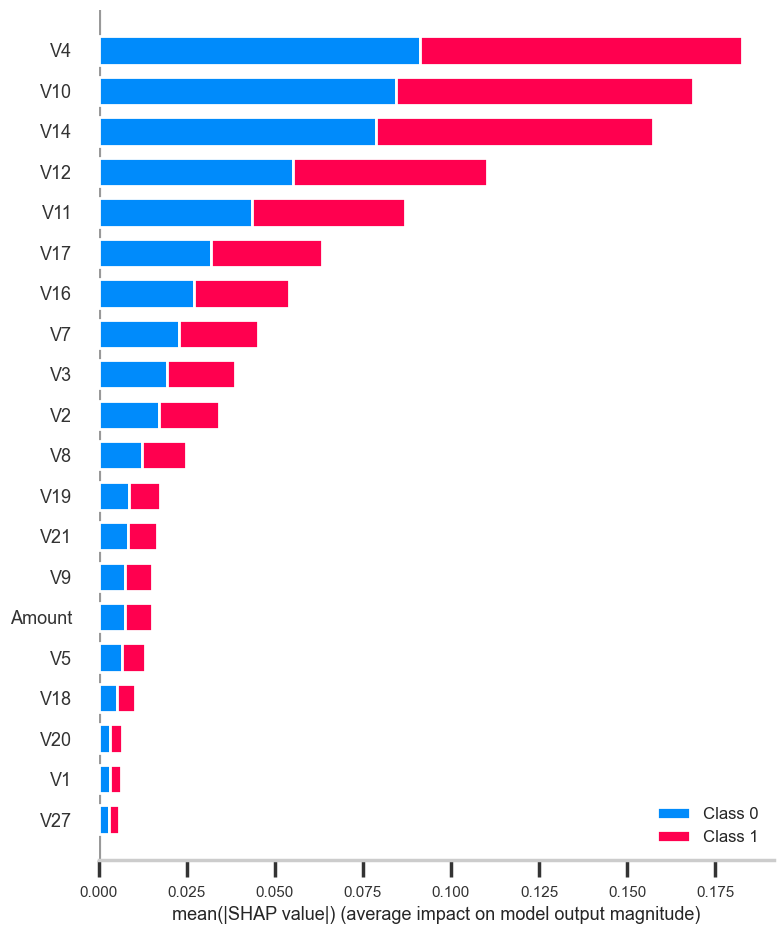

In [373]:
explainer = shap.TreeExplainer(smote_rf_model["rf"])
shap_values = explainer.shap_values(X_test,approximate=True)
shap.summary_plot(shap_values, X_test, plot_type="bar", feature_names=X.columns)

In [374]:
feature = ["V4",  'V14',  'V10', "V11", 'V12'] 

X2 = df[feature]
y = df.Class

In [375]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y, test_size=0.2, random_state=42, stratify =y)

shap_rf_model = RandomForestClassifier(max_depth=7, random_state=42)

shap_rf_model.fit(X_train2, y_train2)

eval_metric(shap_rf_model, X_train2, y_train2, X_test2, y_test2)

Test_Set
[[56643     7]
 [   27    68]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56650
           1       0.91      0.72      0.80        95

    accuracy                           1.00     56745
   macro avg       0.95      0.86      0.90     56745
weighted avg       1.00      1.00      1.00     56745


Train_Set
[[226587     13]
 [    68    310]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    226600
           1       0.96      0.82      0.88       378

    accuracy                           1.00    226978
   macro avg       0.98      0.91      0.94    226978
weighted avg       1.00      1.00      1.00    226978



## 4. Model Deployement
You cooked the food in the kitchen and moved on to the serving stage. The question is how do you showcase your work to others? Model Deployement helps you showcase your work to the world and make better decisions with it. But, deploying a model can get a little tricky at times. Before deploying the model, many things such as data storage, preprocessing, model building and monitoring need to be studied.

Deployment of machine learning models, means making your models available to your other business systems. By deploying models, other systems can send data to them and get their predictions, which are in turn populated back into the company systems. Through machine learning model deployment, can begin to take full advantage of the model you built.

Data science is concerned with how to build machine learning models, which algorithm is more predictive, how to design features, and what variables to use to make the models more accurate. However, how these models are actually used is often neglected. And yet this is the most important step in the machine learning pipline. Only when a model is fully integrated with the business systems, real values ​​can be extract from its predictions.

After doing the following operations in this notebook, jump to a proper IDE and create your web app with Streamlit API.

### Save and Export the Best Model


In [376]:
import pickle

In [377]:
pickle.dump(shap_rf_model, open('pickle_model', 'wb'))
shap_rf_model = pickle.load(open("pickle_model", "rb"))

In [378]:
X2.head()

,V4,V14,V10,V11,V12
0,1.378155,-0.311169,0.090794,-0.551600,-0.617801
1,0.448154,-0.143772,-0.166974,1.612727,1.065235
2,0.379780,-0.165946,0.207643,0.624501,0.066084
3,-0.863291,-0.287924,-0.054952,-0.226487,0.178228
4,0.403034,-1.119670,0.753074,-0.822843,0.538196


In [379]:
# Prediction
random = pd.DataFrame({
        'V4': 1.378155,
        'V14': -0.311169,
        'V10': 0.090794,
        'V11': -0.551600,
        'V12': -0.617801}, index=[0])

In [385]:
predict = shap_rf_model.predict(random)
predict

array([0], dtype=int64)

### Save and Export Variables

___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___